In [1]:
import os, torch
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"  # Arrange GPU devices starting from 0
os.environ["CUDA_VISIBLE_DEVICES"]= "0"  # Set the GPU 2 to use
torch.set_num_threads(16)
# torch.cuda.set_per_process_memory_fraction(0.8, device=None)

In [2]:
import preprocessing
import model

In [3]:
import pandas as pd
import json
import numpy as np

# CSV 파일 읽기
df_loaded = pd.read_csv('ecg_data.csv')

# JSON 문자열을 dictionary로 변환하고, 리스트를 다시 numpy 배열로 복원
def list_to_numpy(d):
    return {k: np.array(v, dtype=np.float32) for k, v in d.items()}

df_loaded['WaveForm'] = df_loaded['WaveForm'].apply(json.loads)
df_loaded['WaveForm'] = df_loaded['WaveForm'].apply(list_to_numpy)

# 확인

In [4]:
# df = preprocessing.p()

In [5]:
df_loaded['Vent'] = df_loaded['Vent'].replace('1->0', '1')

In [6]:
df = df_loaded

In [7]:
df.columns

Index(['index', 'PatientID', 'PatientAge', 'Gender', 'AcquisitionDate',
       'AcquisitionTime', 'VentricularRate', 'AtrialRate', 'PRInterval',
       'QRSDuration', 'QTInterval', 'QTCorrected', 'PAxis', 'RAxis', 'TAxis',
       'QRSCount', 'QOnset', 'QOffset', 'POnset', 'POffset', 'TOffset',
       'QTcFrederica', 'GlobalRR', 'QTRGGR', 'WaveformStartTime',
       'PharmaRRinterval', 'PharmaPPinterval', 'WaveForm', 'Global_RR', 'R',
       'S', 'R/S Ratio', 'ProcessedWaveForm', 'ID', 'Death', 'CMP', 'HF Hosp',
       'Death or HF Hosp', 'BirthD', 'Last_fu_date', 'Death date',
       'initial Echo', 'last echo', ' 50≤EF<55', '40≤EF<50', '30≤EF<40', '<30',
       'CMP_date', 'Hosp_date', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi', 'Age', 'DateTime'],
      dtype='object')

## 시계열 데이터만 이용

### 연구 1

In [8]:
cmp = df[df['CMP'] == 1]
non_cmp = df[df['CMP'] == 0]

cmp = cmp[['PatientID','AcquisitionDate','CMP_date','WaveForm','ProcessedWaveForm']]

In [9]:
# 각 검사별로 cmp 발병 후 몇 개월 지난 시점의 검사인지 정의
import pandas as pd
def convert_to_datetime(val):
    try:
        return pd.to_datetime(val, errors='raise')
    except (ValueError, TypeError):
        return val


cmp['AcquisitionDate'] = pd.to_datetime(cmp['AcquisitionDate'], errors='coerce')
cmp['CMP_date'] = pd.to_datetime(cmp['CMP_date'], errors='coerce')

cmp['AcquisitionDate'] = cmp['AcquisitionDate'].apply(convert_to_datetime)
cmp['CMP_date'] = cmp['CMP_date'].apply(convert_to_datetime)

duration = []
for i in range(len(cmp)):
    duration.append((cmp['AcquisitionDate'].iloc[i] - cmp['CMP_date'].iloc[i]).days/30)

cmp['Duration'] = duration

In [10]:
cmp = cmp[((cmp['Duration'] < 120)& (cmp['Duration'] >0))|(cmp['Duration']< -12)]
cmp

,PatientID,AcquisitionDate,CMP_date,WaveForm,ProcessedWaveForm,Duration
0,2263640,2004-11-29,2018-01-11,"{'I': [0.038, 0.0275021, 0.017004201, 0.006506...","{'I': [-0.0012131458474994648, -0.005677007683...",-159.700000
1,2263640,2004-11-29,2018-01-11,"{'I': [0.038, 0.0275021, 0.017004201, 0.006506...","{'I': [-0.0012131458474994648, -0.005677007683...",-159.700000
2,2260375,2004-12-09,2013-02-01,"{'I': [0.082, 0.082, 0.082, 0.082, 0.082, 0.08...","{'I': [0.005546101694525797, 0.005843131557909...",-99.200000
3,2258487,2005-01-05,2011-01-04,"{'I': [0.014, 0.014, 0.014, 0.014, 0.014, 0.01...","{'I': [-0.004439156132121413, -0.0044834743530...",-73.000000
11,2231914,2005-01-24,2013-02-23,"{'I': [-0.016, -0.0150002, -0.0140004, -0.0130...","{'I': [-0.0004965381863754915, -0.000300691824...",-98.400000
...,...,...,...,...,...,...
4419,2428348,2022-05-31,2018-10-11,"{'I': [0.096, 0.096, 0.096, 0.096, 0.11, 0.122...","{'I': [0.03311010918821891, 0.0340808618331969...",44.266667
4423,2451959,2022-06-04,2020-06-30,"{'I': [-0.024, -0.024, -0.024, -0.024, -0.024,...","{'I': [-0.0006006569980565544, -0.000619790539...",23.466667
4424,2451959,2022-06-04,2020-06-30,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.008,...","{'I': [0.00040074403204265366, 0.0003579716361...",23.466667
4425,2547595,2022-06-05,2014-01-15,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...","{'I': [-0.003243415944593691, -0.0030464845567...",102.100000


In [11]:
label=[]
for i in range(len(cmp)):
    if (cmp['Duration'].iloc[i] < 120)& (cmp['Duration'].iloc[i] >0):
        label.append(1)
    elif (cmp['Duration'].iloc[i]< -12):
        label.append(0)

In [12]:
cmp['Label'] = label

In [13]:
cmp['Label'].value_counts()

1    2390
0     574
Name: Label, dtype: int64

In [14]:
non_cmp['Label'] = [0]*len(non_cmp)

In [15]:
non_cmp

,index,PatientID,PatientAge,Gender,AcquisitionDate,AcquisitionTime,VentricularRate,AtrialRate,PRInterval,QRSDuration,...,Hosp_date,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Age,DateTime,Label
10,0,2267805,11.0,MALE,2005-01-18,16:26:00,103.0,103.0,98.0,86.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,2005-01-18 16:26:00,0
14,0,2262496,3.0,MALE,2005-01-27,15:53:00,94.0,94.0,146.0,82.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-3.0,2005-01-27 15:53:00,0
18,0,2264086,3.0,MALE,2005-03-09,11:04:00,152.0,152.0,102.0,74.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,2005-03-09 11:04:00,0
28,0,2281933,7.0,MALE,2005-09-14,17:46:00,78.0,98.0,124.0,84.0,...,NaN,NaN,1,NaN,1.0,NaN,1.0,7.0,2005-09-14 17:46:00,0
29,0,2279170,6.0,MALE,2005-09-22,11:44:00,88.0,88.0,112.0,88.0,...,NaN,NaN,1,NaN,NaN,NaN,NaN,6.0,2005-09-22 11:44:00,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4386,0,2534302,12.0,MALE,2022-05-13,11:18:00,103.0,103.0,118.0,92.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,2022-05-13 11:18:00,0
4392,0,2645362,7.0,MALE,2022-05-17,10:20:00,100.0,100.0,118.0,88.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,2022-05-17 10:20:00,0
4413,0,2652198,9.0,MALE,2022-05-26,14:05:00,97.0,97.0,108.0,80.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.0,2022-05-26 14:05:00,0
4417,0,2440113,13.0,MALE,2022-05-30,15:29:00,120.0,120.0,146.0,92.0,...,NaN,NaN,1,NaN,NaN,NaN,NaN,13.0,2022-05-30 15:29:00,0


In [16]:
tot_df = pd.concat((cmp,non_cmp))

In [17]:
tot_df.Label.value_counts()

1    2390
0    1208
Name: Label, dtype: int64

#### 그냥 CNN

In [18]:
# model.CNN_MODEL(tot_df, batch_size = 32, epoch = 100, waveform = 'ProcessedWaveForm')
model.CNN_MODEL(tot_df, batch_size = 32, epoch = 100, waveform = 'WaveForm')
# model.CNN_MODEL(tot_df, batch_size = 32, epoch = 200)
# model.CNN_MODEL(tot_df, batch_size = 64, epoch = 200)

(3253, 12, 5000)
(3253,)
Epoch [10/100], Train Loss: 0.1951
Epoch [20/100], Train Loss: 0.1273
Epoch [30/100], Train Loss: 0.0733
Epoch [40/100], Train Loss: 0.0822
Epoch [50/100], Train Loss: 0.0519
Epoch [60/100], Train Loss: 0.0615
Epoch [70/100], Train Loss: 0.0475
Epoch [80/100], Train Loss: 0.0437
Epoch [90/100], Train Loss: 0.0330
Epoch [100/100], Train Loss: 0.0280
Training complete.
Test Accuracy: 0.7942
Test ROC AUC Score: 0.8359


#### Tabular Added

In [50]:
# table = tot_df[['scoliosis OP','Vent', 
#     'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
table = tot_df[['scoliosis OP','Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [51]:
concat_table = pd.merge(tot_df[['PatientID','AcquisitionDate','WaveForm','ProcessedWaveForm','Label']], table, how='left', on=['PatientID','AcquisitionDate'])

In [52]:
concat_table.columns

Index(['PatientID', 'AcquisitionDate', 'WaveForm', 'ProcessedWaveForm',
       'Label', 'Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi'],
      dtype='object')

In [53]:
waveform = 'WaveForm'
# tabular_features = ['Age', 'Gender', 'scoliosis OP', 'Vent', 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']
tabular_features = ['Age', 'Gender', 'scoliosis OP', 'Vent','Arrhythmia', 'BB', 'ARB ', 'ACEi']
batch_size = 32
epoch = 100
model.CNN_MODEL_TABULAR_ADDED(concat_table, batch_size, epoch, waveform, tabular_features)


(3257, 12, 5000)
(3257,)
Epoch [10/100], Train Loss: 0.2093
Epoch [20/100], Train Loss: 0.1051
Epoch [30/100], Train Loss: 0.0888
Epoch [40/100], Train Loss: 0.0617
Epoch [50/100], Train Loss: 0.0561
Epoch [60/100], Train Loss: 0.0471
Epoch [70/100], Train Loss: 0.0356
Epoch [80/100], Train Loss: 0.0395
Epoch [90/100], Train Loss: 0.0445
Epoch [100/100], Train Loss: 0.0246
Training complete.
Test Accuracy: 0.8087
Test ROC AUC Score: 0.8464


#### Vision Transformer

In [18]:
# 사용 예시
vit_patch_size=20
vit_hidden_size=768
vit_depth=12
vit_num_heads=12
vit_mlp_dim=256
df = tot_df

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=8, epochs=10, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

2024-09-06 07:34:39.884193: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2024-09-06 07:34:39.884238: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: fabfca9f189e
2024-09-06 07:34:39.884247: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: fabfca9f189e
2024-09-06 07:34:39.884412: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: NOT_FOUND: was unable to find libcuda.so DSO loaded into this program
2024-09-06 07:34:39.884442: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 535.171.4
2024-09-06 07:34:39.884788: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in 

Epoch 1/10
160/407 [==========>...................] - ETA: 7:59 - loss: 0.6920 - roc_auc: 0.6944 - accuracy: 0.6742

KeyboardInterrupt: 

In [29]:
tot_df[tot_df['PatientID'] == 2172946]

,PatientID,AcquisitionDate,CMP_date,WaveForm,ProcessedWaveForm,Duration,Label,index,PatientAge,Gender,...,<30,Hosp_date,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Age,DateTime
99,2172946,2007-11-29 00:00:00,2005-01-13 00:00:00,"{'I': [0.004, 0.004, 0.004, 0.004, 0.004, 0.00...","{'I': [-0.0022919448555837377, -0.002720848267...",35.000000,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
100,2172946,2007-11-30 00:00:00,2005-01-13 00:00:00,"{'I': [0.04, 0.04, 0.04, 0.04, 0.037, 0.036, 0...","{'I': [0.007486217259291224, 0.007405812313887...",35.033333,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
101,2172946,2007-11-30 00:00:00,2005-01-13 00:00:00,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...","{'I': [-0.003127741889744482, -0.0027206576686...",35.033333,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
102,2172946,2007-12-01 00:00:00,2005-01-13 00:00:00,"{'I': [0.019, 0.019, 0.019, 0.016501501, 0.014...","{'I': [0.001962490903109612, 0.001020334320675...",35.066667,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
135,2172946,2008-05-12 00:00:00,2005-01-13 00:00:00,"{'I': [0.014, 0.013, 0.01, 0.01, 0.01, 0.009, ...","{'I': [-0.0005542675403882715, -0.001543235138...",40.500000,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
233,2172946,2009-06-23 00:00:00,2005-01-13 00:00:00,"{'I': [-0.05, -0.05, -0.05, -0.05, -0.045, -0....","{'I': [-0.006823983221146091, -0.0057982130322...",54.066667,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
325,2172946,2010-06-11 00:00:00,2005-01-13 00:00:00,"{'I': [-0.018, -0.018, -0.018, -0.018, -0.015,...","{'I': [0.011262775347032943, 0.013526773488117...",65.833333,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
326,2172946,2010-06-11 00:00:00,2005-01-13 00:00:00,"{'I': [0.004, 0.004, 0.004, 0.004, 0.002, 0.00...","{'I': [0.0006005158889956145, 0.00054437911553...",65.833333,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
327,2172946,2010-06-12 00:00:00,2005-01-13 00:00:00,"{'I': [0.004, 0.004, 0.004, 0.004, 0.003, 0.00...","{'I': [8.670476697440803e-05, -0.0003279892233...",65.866667,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
381,2172946,2011-01-13 00:00:00,2005-01-13 00:00:00,"{'I': [-0.068, -0.068, -0.068, -0.068, -0.066,...","{'I': [-0.01284735132593674, -0.01307427393129...",73.033333,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


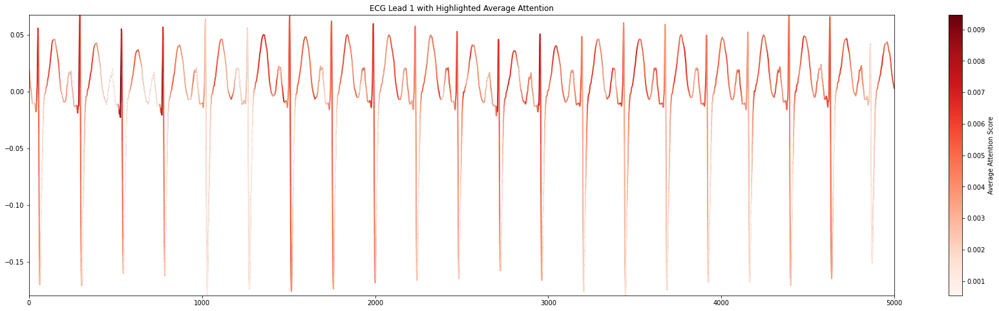

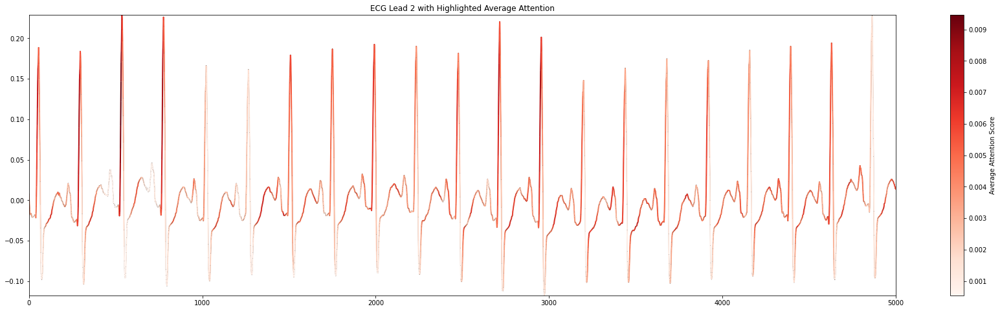

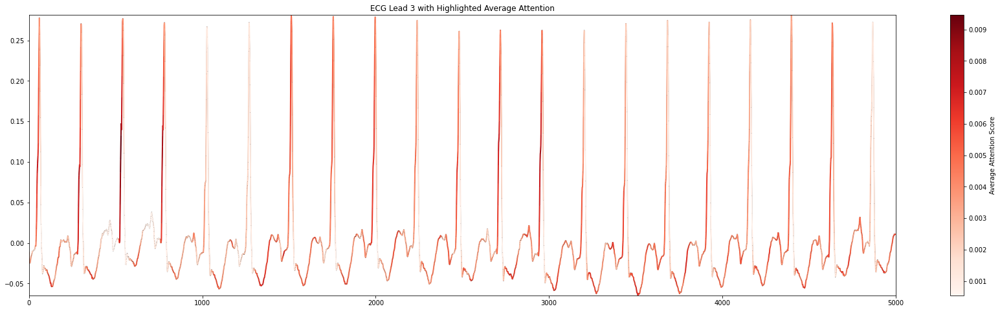

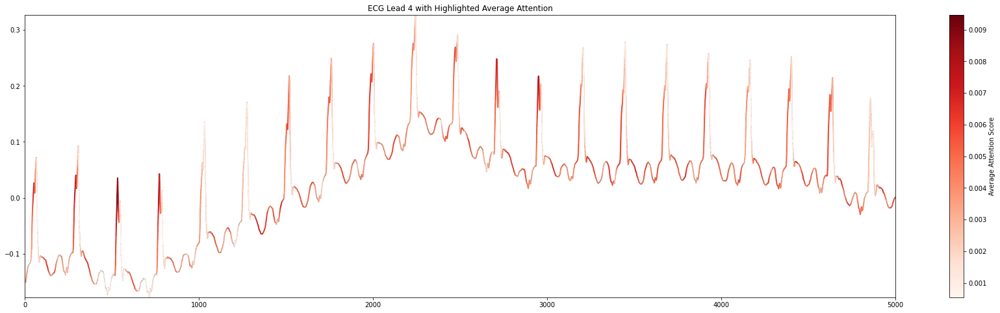

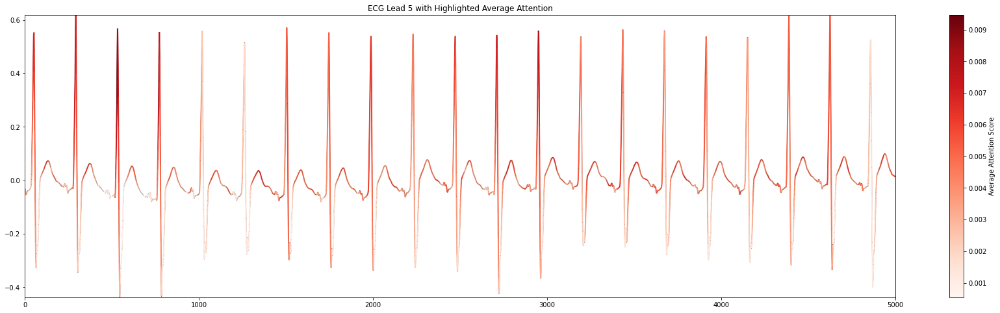

...

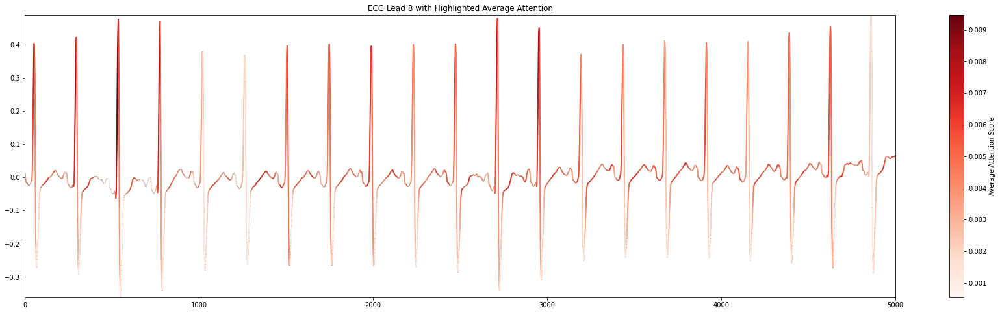

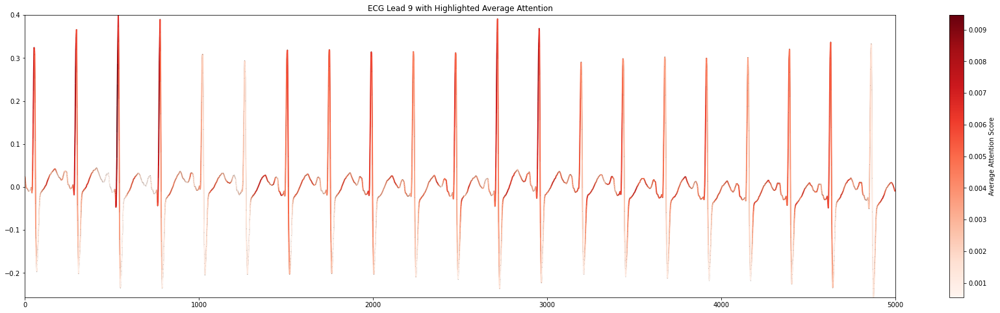

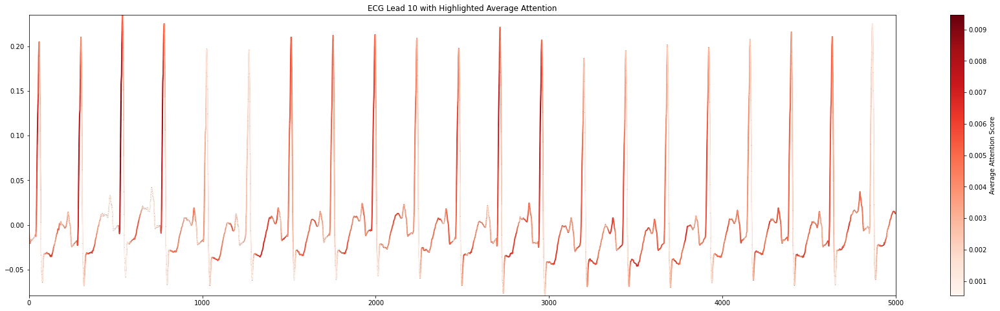

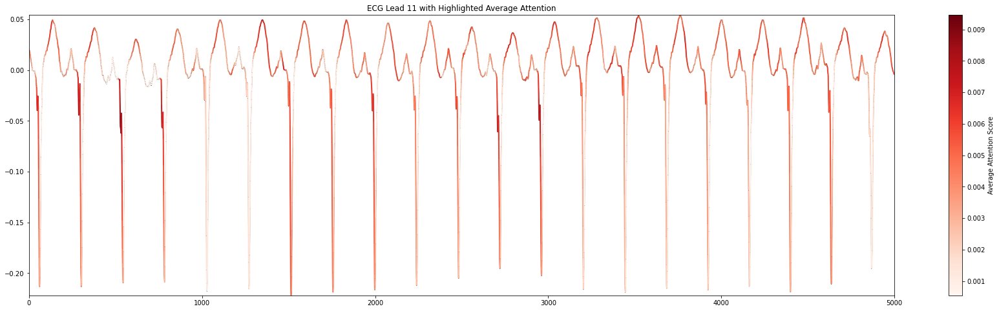

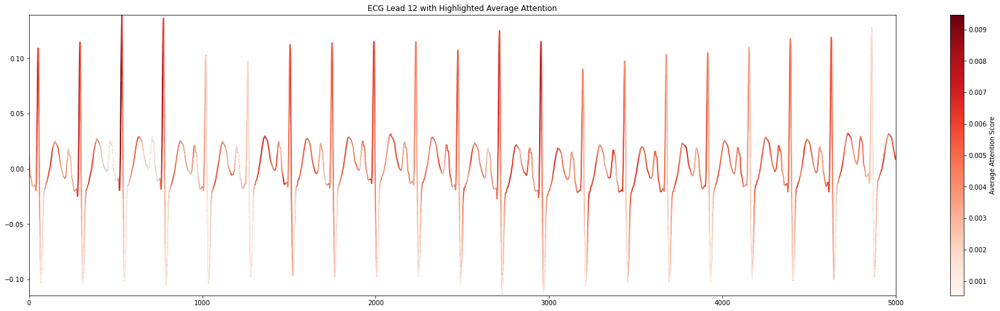

In [30]:
# 사용 예시

ex_df = tot_df[tot_df['PatientID'] == 2260159].iloc[3]
ex_df = tot_df[tot_df['PatientID'] == 2260188].iloc[4]
ex_df = tot_df[tot_df['PatientID'] == 2247933].iloc[1]
ex_df = tot_df[tot_df['PatientID'] == 2172946].iloc[3]
ecg_data = np.vstack([ex_df['WaveForm'][lead] for lead in sorted(ex_df['WaveForm'].keys())]).T  # (12, 5000) -> (5000, 12)
for i in range(12):
    model.plot_ecg_attention(ecg_data, vit, lead_index=i, weights_path='vit_best/')

In [ ]:
df.columns

Index(['Unnamed: 0', 'op_id', 'subject_id', 'Heart Rate', 'Resp', 'nibp_dbp',
       'nibp_sbp', 'Creatinine', 'Urea nitrogen', 'Bilirubin', 'Albumin',
       'Chloride', 'Coagulation surface induced', 'Alkaline phosphatase',
       'Platelets', 'Sodium', 'Coagulation tissue factor induced.INR',
       'Aspartate aminotransferase', 'Protein',
       'Coagulation surface induced.1', 'Glucose', 'stage', 'IN_OR_DTTM',
       'baseline', 'weight', 'BIRTH_DATE', 'sex', 'antype', 'asa',
       'PRIMARY_PROCEDURE_NM', 'OUT_OR_DTTM', 'icd9', 'System'],
      dtype='object')

In [ ]:
# 사용 예시
vit, results = run_vit_training_patient(df, batch_size=32, epochs=20, test_size=0.1, 
                                        vit_patch_size = vit_patch_size,
                                        vit_hidden_size = vit_hidden_size,
                                        vit_depth = vit_depth,
                                        vit_num_heads = vit_num_heads,
                                        vit_mlp_dim = vit_mlp_dim)
print(results)

# 사용 예시
ecg_data = np.vstack([tot_df['WaveForm'].iloc[0][lead] for lead in sorted(tot_df['WaveForm'].iloc[0].keys())]).T  # (12, 5000) -> (5000, 12)
model.plot_ecg_attention(ecg_data, vit, lead_index=11, weights_path='vit_best_patient/')

### 연구 2 - Death

In [32]:
### CMP 걸리지 않고 사망한 환자 제외
final_data = df
dead_with_no_cmp = final_data[(final_data['Death'] == 1) & (final_data['CMP'] == 0)].PatientID.unique()
# final_data = final_data[~final_data['PatientID'].isin(dead_with_no_cmp)]


In [33]:
len(dead_with_no_cmp)

14

In [34]:
cmp = df[df['CMP'] == 1]
non_cmp = df[df['CMP'] == 0]

In [35]:
len(non_cmp)

634

In [36]:
cmp = cmp[['PatientID','Age','AcquisitionDate','CMP_date','WaveForm','Death','Death date','ProcessedWaveForm','Gender', 'scoliosis OP', 'Vent',
       # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker','digoxin', 'Entresto']]
           'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

In [37]:
# 각 검사별로 cmp 발병 후 몇 개월 지난 시점의 검사인지 정의
import pandas as pd
def convert_to_datetime(val):
    try:
        return pd.to_datetime(val, errors='raise')
    except (ValueError, TypeError):
        return val


cmp['AcquisitionDate'] = pd.to_datetime(cmp['AcquisitionDate'], errors='coerce')
cmp['CMP_date'] = pd.to_datetime(cmp['CMP_date'], errors='coerce')
cmp['Death date'] = pd.to_datetime(cmp['Death date'], errors='coerce')

cmp['AcquisitionDate'] = cmp['AcquisitionDate'].apply(convert_to_datetime)
cmp['CMP_date'] = cmp['CMP_date'].apply(convert_to_datetime)
cmp['Death date'] = cmp['Death date'].apply(convert_to_datetime)

duration = []
for i in range(len(cmp)):
    duration.append((cmp['AcquisitionDate'].iloc[i] - cmp['CMP_date'].iloc[i]).days/30)

cmp['Duration'] = duration

In [38]:
cmp_dead = cmp[cmp['Death'] == 1]
cmp_live = cmp[cmp['Death'] == 0]

In [39]:
death_duration = []
for i in range(len(cmp_dead)):
    death_duration.append((cmp_dead['Death date'].iloc[i] - cmp_dead['CMP_date'].iloc[i]).days/30)

cmp_dead['Death Duration'] = death_duration
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Death Duration
5,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333
6,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333
7,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
8,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
9,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4375,2240081,21.0,2022-05-06,2016-09-06,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.004,...",1,2022-05-23,"{'I': [0.006718929945392245, 0.007023910852599...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,68.933333,69.500000
4384,2240081,21.0,2022-05-11,2016-09-06,"{'I': [-0.036, -0.036, -0.036, -0.036, -0.042,...",1,2022-05-23,"{'I': [0.005478621598964072, 0.005098959506057...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,69.100000,69.500000
4399,2451959,25.0,2022-05-19,2020-06-30,"{'I': [-0.004, -0.004, -0.004, -0.004, -0.003,...",1,2022-10-06,"{'I': [0.008975516330010288, 0.009795517113387...",MALE,NaN,1,NaN,1.0,NaN,1.0,22.933333,27.600000
4423,2451959,25.0,2022-06-04,2020-06-30,"{'I': [-0.024, -0.024, -0.024, -0.024, -0.024,...",1,2022-10-06,"{'I': [-0.0006006569980565544, -0.000619790539...",MALE,NaN,1,NaN,1.0,NaN,1.0,23.466667,27.600000


In [40]:
cmp_dead = cmp_dead[(cmp_dead['Death Duration']< 120) & (cmp_dead['Duration']< 12) &  (cmp_dead['Duration']> -12)]
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Death Duration
5,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333
6,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333
7,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
8,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
9,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3876,2451959,24.0,2021-06-10,2020-06-30,"{'I': [-0.124, -0.124, -0.124, -0.124, -0.122,...",1,2022-10-06,"{'I': [-0.0030212416490314723, -0.002489666804...",MALE,NaN,1,NaN,1.0,NaN,1.0,11.500000,27.600000
3877,2242703,24.0,2021-06-14,2020-08-14,"{'I': [-0.004, -0.004, -0.004, -0.004, -0.004,...",1,2022-01-30,"{'I': [1.9371245988882253e-05, 2.1579842904491...",MALE,1.0,1,NaN,1.0,NaN,1.0,10.133333,17.800000
3899,2242703,24.0,2021-06-28,2020-08-14,"{'I': [0.204, 0.204, 0.204, 0.204, 0.206, 0.20...",1,2022-01-30,"{'I': [-0.003582075962636506, -0.0033718212914...",MALE,1.0,1,NaN,1.0,NaN,1.0,10.600000,17.800000
3916,2242703,24.0,2021-07-12,2020-08-14,"{'I': [0.008, 0.008, 0.008, 0.008, 0.006, 0.00...",1,2022-01-30,"{'I': [-0.00023018628251081965, -0.00041285193...",MALE,1.0,1,NaN,1.0,NaN,1.0,11.066667,17.800000


In [41]:
cmp_live = cmp_live[(cmp_live['Duration']< 12) &  (cmp_live['Duration']> -12)]
cmp_live

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration
4,2239346,9.0,2005-01-11,2005-01-11,"{'I': [0.052, 0.0495005, 0.047001, 0.044501502...",0,NaT,"{'I': [0.004514198748816069, 0.003194146326561...",MALE,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
13,2226404,11.0,2005-01-25,2004-02-10,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.028,...",0,NaT,"{'I': [-0.00020565907829224136, -0.00034107055...",MALE,NaN,1,1.0,1.0,1.0,1.0,11.666667
15,2235939,9.0,2005-02-15,2005-02-15,"{'I': [-0.01, -0.0095001, -0.0090002, -0.00850...",0,NaT,"{'I': [-0.0005273930803200092, -0.000325907737...",MALE,1.0,1,NaN,1.0,NaN,1.0,0.000000
23,2272056,4.0,2005-06-08,2005-06-08,"{'I': [-0.004, -0.0035001, -0.0030002, -0.0025...",0,NaT,"{'I': [0.0004472554469533127, 0.00096184866296...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000
31,2235939,9.0,2005-11-21,2005-02-15,"{'I': [-0.002, -0.0044994997, -0.006999, -0.00...",0,NaT,"{'I': [9.803671486120189e-05, -0.0006126662446...",MALE,1.0,1,NaN,1.0,NaN,1.0,9.300000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4396,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667
4402,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000
4416,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,6.433333
4421,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000


In [42]:
cmp_dead['Label'] =[1]*len(cmp_dead)
cmp_live['Label'] = [0]*len(cmp_live)

In [43]:
tot_df = pd.concat((cmp_dead,cmp_live), ignore_index=True)
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Death Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
747,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667,NaN,0
748,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000,NaN,0
749,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,6.433333,NaN,0
750,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [44]:
tot_df['Label'].value_counts()

0    544
1    208
Name: Label, dtype: int64

In [65]:
# model.CNN_MODEL(tot_df, epoch = 100, batch_size = 32)
model.CNN_MODEL(tot_df, epoch = 100, batch_size = 32, waveform='WaveForm')
# model.CNN_MODEL(tot_df, epoch = 200, batch_size = 32)
# model.CNN_MODEL(tot_df, epoch = 200, batch_size = 64)

(391, 12, 5000)
(391,)
Epoch [10/100], Train Loss: 0.1359
Epoch [20/100], Train Loss: 0.0958
Epoch [30/100], Train Loss: 0.1198
Epoch [40/100], Train Loss: 0.0673
Epoch [50/100], Train Loss: 0.0632
Epoch [60/100], Train Loss: 0.0664
Epoch [70/100], Train Loss: 0.0661
Epoch [80/100], Train Loss: 0.0445
Epoch [90/100], Train Loss: 0.0489
Epoch [100/100], Train Loss: 0.0733
Training complete.
Test Accuracy: 0.4660
Test ROC AUC Score: 0.7446


#### Tabular Added

In [66]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Death Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,2608828,14.0,2022-05-17,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0,NaT,"{'I': [-0.005122427363618091, -0.0056354071314...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0
490,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667,NaN,0
491,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000,NaN,0
492,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [67]:
table = tot_df[['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [68]:
concat_table = pd.merge(tot_df[['PatientID','AcquisitionDate','WaveForm','ProcessedWaveForm','Label']], table, how='left', on=['PatientID','AcquisitionDate'])

In [69]:
concat_table

,PatientID,AcquisitionDate,WaveForm,ProcessedWaveForm,Label,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2172946,2005-01-12,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...","{'I': [0.003489078248510284, 0.003424048884589...",1,0.487179,1,0,1,0,0,0,1
1,2172946,2005-01-12,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...","{'I': [-0.001092086502907418, -0.0007955816212...",1,0.487179,1,0,1,0,0,0,1
2,2172946,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...","{'I': [-0.00071312700637069, -0.00044829021713...",1,0.487179,1,0,1,0,0,0,1
3,2172946,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...","{'I': [-0.002769777877337562, -0.0027443359588...",1,0.487179,1,0,1,0,0,0,1
4,2172946,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...","{'I': [-0.001887300273430698, -0.0017362243296...",1,0.487179,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,2608828,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....","{'I': [-0.005122427363618091, -0.0056354071314...",0,0.307692,1,0,0,0,0,0,1
490,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...","{'I': [-0.0009398949308504023, -0.000745406959...",0,0.333333,1,0,0,0,1,1,1
491,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....","{'I': [0.0010573135514592076, -3.8200843735528...",0,0.282051,1,0,0,0,1,0,1
492,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....","{'I': [0.0010583006490491778, 0.00131258523873...",0,0.358974,1,0,0,0,0,0,1


In [70]:
concat_table.columns

Index(['PatientID', 'AcquisitionDate', 'WaveForm', 'ProcessedWaveForm',
       'Label', 'Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi'],
      dtype='object')

In [71]:
waveform = 'WaveForm'
tabular_features = ['Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']#'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']
batch_size = 64
epoch = 200
model.CNN_MODEL_TABULAR_ADDED(concat_table, batch_size, epoch, waveform, tabular_features)


(391, 12, 5000)
(391,)
Epoch [10/200], Train Loss: 0.0659
Epoch [20/200], Train Loss: 0.0310
Epoch [30/200], Train Loss: 0.0303
Epoch [40/200], Train Loss: 0.0324
Epoch [50/200], Train Loss: 0.0243
Epoch [60/200], Train Loss: 0.0100
Epoch [70/200], Train Loss: 0.0192
Epoch [80/200], Train Loss: 0.0084
Epoch [90/200], Train Loss: 0.0113
Epoch [100/200], Train Loss: 0.0136
Epoch [110/200], Train Loss: 0.0158
Epoch [120/200], Train Loss: 0.0054
Epoch [130/200], Train Loss: 0.0090
Epoch [140/200], Train Loss: 0.0306
Epoch [150/200], Train Loss: 0.0005
Epoch [160/200], Train Loss: 0.0123
Epoch [170/200], Train Loss: 0.0121
Epoch [180/200], Train Loss: 0.0046
Epoch [190/200], Train Loss: 0.0199
Epoch [200/200], Train Loss: 0.0068
Training complete.
Test Accuracy: 0.5728
Test ROC AUC Score: 0.8092


#### 사람별

In [72]:
import model

In [73]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,Death,Death date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Death Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,NaN,NaN,NaN,1.0,-0.033333,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,NaN,NaN,NaN,1.0,0.000000,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,2608828,14.0,2022-05-17,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0,NaT,"{'I': [-0.005122427363618091, -0.0056354071314...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0
490,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667,NaN,0
491,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000,NaN,0
492,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [74]:
tot_df
# df = filtered_df
dff = pd.DataFrame({'PatientID':[],'AcquisitionDate':[],'WaveForm':[],'Label':[],'DeathDate':[]})
label = []
WaveForm = []
patient_id = []
date = []
death_date=[]
# age = []
unique_patients = tot_df.PatientID.unique().tolist()
for patient in unique_patients:
    a = tot_df[tot_df['PatientID'] == patient]
    for i in range(len(a)):
        label.append(a['Death'].unique()[0])
        date.append(a['AcquisitionDate'].iloc[i])
        WaveForm.append(a['WaveForm'].iloc[i]) # WaveForm vs ProcessedWaveForm 결정
        patient_id.append(a['PatientID'].iloc[i])
        # age.append(a['Age'].iloc[i])
        death_date.append(tot_df[tot_df['PatientID'] == patient]['Death date'].iloc[0])
dff['WaveForm'] = WaveForm
dff['AcquisitionDate'] = date
dff['DeathDate'] = death_date
dff['Label'] = label
dff['PatientID'] = patient_id
# dff['Age'] = age

In [75]:
dff[dff['PatientID'] == 2172946]

,PatientID,AcquisitionDate,WaveForm,Label,DeathDate
0,2172946,2005-01-12,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",1,2011-01-22
1,2172946,2005-01-12,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",1,2011-01-22
2,2172946,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1,2011-01-22
3,2172946,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1,2011-01-22
4,2172946,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",1,2011-01-22


In [76]:

    # lstm_input_size = 12  # Number of features (channels)
    # hidden_size = 64  # Number of LSTM units
    # lstm_output_size = 32  # Embedding size
    # num_epochs = 20
    
    # batch_size = 8  # Batch size for DataLoader
    # num_epochs_cnn = 100  # Number of epochs for CNN training


# def LSTM_CNN_MODEL(tot_df, lstm_input_size, hidden_size, lstm_output_size,num_epochs,batch_size,num_epochs_cnn):

In [77]:
# tot_df-> 사람별로 바꾸기

In [82]:
model.LSTM_CNN_MODEL(dff,
                    lstm_input_size = 12,
                    hidden_size = 64,
                    lstm_output_size = 32,
                    num_epochs = 20,
                    batch_size = 64,
                    num_epochs_cnn = 100,
                    waveform='WaveForm')

Epoch 1/20, Loss: 0.0672416016459465
Epoch 2/20, Loss: 0.1677708625793457
Epoch 3/20, Loss: 0.11157424002885818
Epoch 4/20, Loss: 0.06873568147420883
Epoch 5/20, Loss: 0.06731170415878296
Epoch 6/20, Loss: 0.1276344507932663
Epoch 7/20, Loss: 0.21890293061733246
Epoch 8/20, Loss: 0.11626140028238297
Epoch 9/20, Loss: 1.7019184827804565
Epoch 10/20, Loss: 0.14537952840328217
Epoch 11/20, Loss: 2.601750612258911
Epoch 12/20, Loss: 0.07122348994016647
Epoch 13/20, Loss: 0.1296008974313736
Epoch 14/20, Loss: 0.140101358294487
Epoch 15/20, Loss: 1.978253722190857
Epoch 16/20, Loss: 0.08594070374965668
Epoch 17/20, Loss: 0.15272146463394165
Epoch 18/20, Loss: 0.17779512703418732
Epoch 19/20, Loss: 0.09373615682125092
Epoch 20/20, Loss: 0.10411491990089417
Train embeddings shape: (229, 32)
Train labels shape: (229, 1)
Test embeddings shape: (26, 32)
Test labels shape: (26, 1)
CNN Epoch 10/100, Loss: 0.328
CNN Epoch 20/100, Loss: 0.410
CNN Epoch 30/100, Loss: 0.250
CNN Epoch 40/100, Loss: 0.26

#### 사람별 + tabular

In [27]:

table = tot_df[['scoliosis OP','Vent', 
# 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [28]:
concat_table = pd.merge(dff, table, how='left', on=['PatientID', 'AcquisitionDate'])

In [79]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, roc_auc_score
import numpy as np
from scipy.interpolate import interp1d
import pandas as pd

# Usage:
tot_df = concat_table
waveform = 'WaveForm'
lstm_input_size = 12
mlp_input_size = 8


num_epochs_cnn = 100
batch_size = 32
num_epochs = 20
hidden_size = 64
lstm_output_size = 64
num_epochs = 20
mlp_hidden_size = 64
mlp_output_size = 64
# tabular_features = ['Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']
models = model.LSTM_CNN_MODEL_TABULAR_ADDED(tot_df, waveform, lstm_input_size, hidden_size, lstm_output_size, mlp_input_size, mlp_hidden_size, mlp_output_size, num_epochs, batch_size, num_epochs_cnn)
models.run()


Epoch 1/20, Loss: 0.12777356803417206
Epoch 2/20, Loss: 0.1998169869184494
Epoch 3/20, Loss: 0.22728867828845978
Epoch 4/20, Loss: 0.21826517581939697
Epoch 5/20, Loss: 0.14402785897254944
Epoch 6/20, Loss: 2.169177532196045
Epoch 7/20, Loss: 0.10522987693548203
Epoch 8/20, Loss: 0.09436637908220291
Epoch 9/20, Loss: 0.1640271097421646
Epoch 10/20, Loss: 2.084914207458496
Epoch 11/20, Loss: 0.11390626430511475
Epoch 12/20, Loss: 0.13871969282627106
Epoch 13/20, Loss: 0.07422856241464615
Epoch 14/20, Loss: 0.14362864196300507
Epoch 15/20, Loss: 0.11050914227962494
Epoch 16/20, Loss: 0.19327257573604584
Epoch 17/20, Loss: 0.21635030210018158
Epoch 18/20, Loss: 0.07001803815364838
Epoch 19/20, Loss: 0.19550351798534393
Epoch 20/20, Loss: 0.09631030261516571
MLP Epoch 1/20, Loss: 3.7956624031066895
MLP Epoch 2/20, Loss: 3.6498959064483643
MLP Epoch 3/20, Loss: 3.310467481613159
MLP Epoch 4/20, Loss: 3.2121810913085938
MLP Epoch 5/20, Loss: 2.8749992847442627
MLP Epoch 6/20, Loss: 2.4408884

#### Vision Transformer

In [18]:
# 사용 예시
vit_patch_size=20
vit_hidden_size=768
vit_depth=24
vit_num_heads=24
vit_mlp_dim=256
df = tot_df

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=32, epochs=10, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

2024-09-06 07:43:29.552944: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2024-09-06 07:43:29.553001: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: fabfca9f189e
2024-09-06 07:43:29.553011: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: fabfca9f189e
2024-09-06 07:43:29.553371: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: NOT_FOUND: was unable to find libcuda.so DSO loaded into this program
2024-09-06 07:43:29.553419: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 535.171.4
2024-09-06 07:43:29.553913: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in 

Epoch 1/10
  8/102 [=>............................] - ETA: 33:39 - loss: 1.5337 - roc_auc: 0.5565 - accuracy: 0.5625

KeyboardInterrupt: 

In [60]:
df[df['PatientID'] == 2172946]

,index,PatientID,PatientAge,Gender,AcquisitionDate,AcquisitionTime,VentricularRate,AtrialRate,PRInterval,QRSDuration,...,CMP_date,Hosp_date,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Age,DateTime
5,0,2172946,NaN,MALE,2005-01-12,04:24:00,126.0,126.0,134.0,130.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,21.0,2005-01-12 04:24:00
6,0,2172946,NaN,MALE,2005-01-12,22:23:00,147.0,147.0,132.0,116.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,21.0,2005-01-12 22:23:00
7,0,2172946,NaN,MALE,2005-01-13,00:55:00,120.0,120.0,126.0,148.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,21.0,2005-01-13 00:55:00
8,0,2172946,NaN,MALE,2005-01-13,01:22:00,122.0,122.0,122.0,150.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,21.0,2005-01-13 01:22:00
9,0,2172946,NaN,MALE,2005-01-13,07:02:00,104.0,104.0,126.0,118.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,21.0,2005-01-13 07:02:00
99,0,2172946,NaN,MALE,2007-11-29,22:41:00,110.0,110.0,140.0,124.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,24.0,2007-11-29 22:41:00
100,0,2172946,NaN,MALE,2007-11-30,01:06:00,97.0,97.0,122.0,122.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,24.0,2007-11-30 01:06:00
101,0,2172946,NaN,MALE,2007-11-30,01:23:00,94.0,94.0,124.0,120.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,24.0,2007-11-30 01:23:00
102,0,2172946,24.0,MALE,2007-12-01,10:31:00,124.0,124.0,124.0,112.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,24.0,2007-12-01 10:31:00
135,0,2172946,24.0,MALE,2008-05-12,22:02:00,101.0,101.0,126.0,128.0,...,2005-01-13,NaN,NaN,1,NaN,NaN,NaN,1.0,25.0,2008-05-12 22:02:00


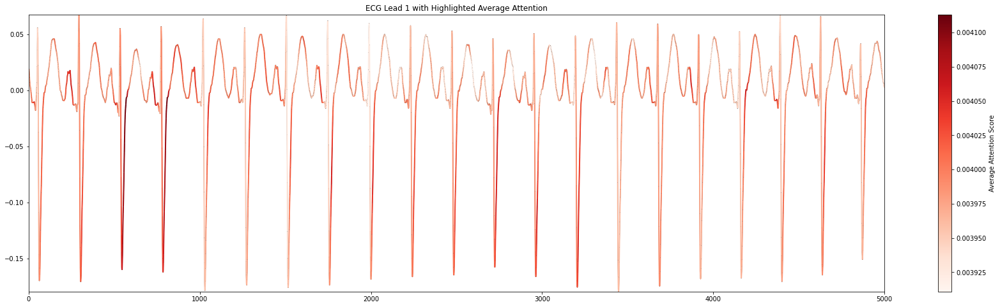

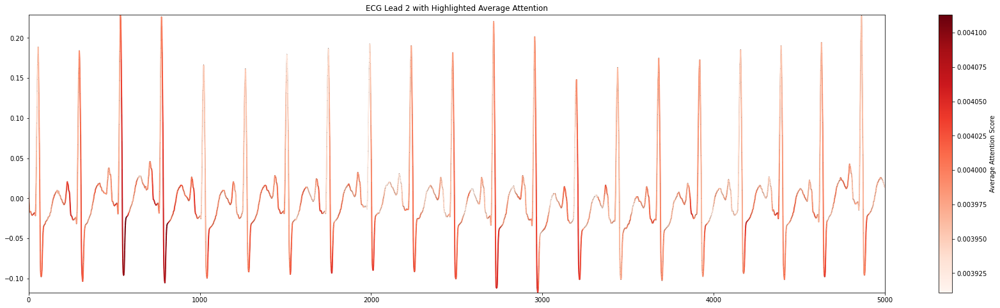

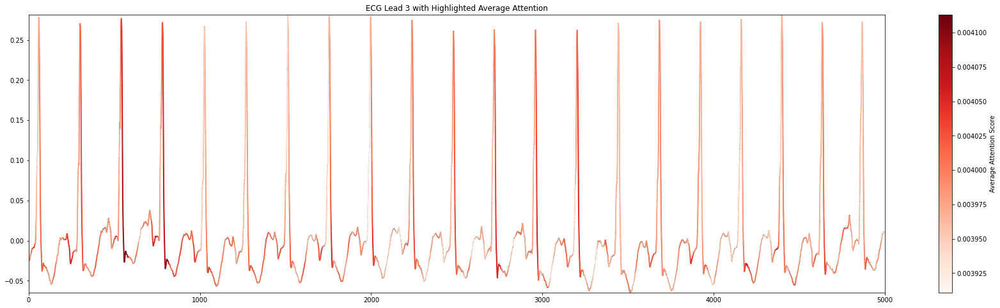

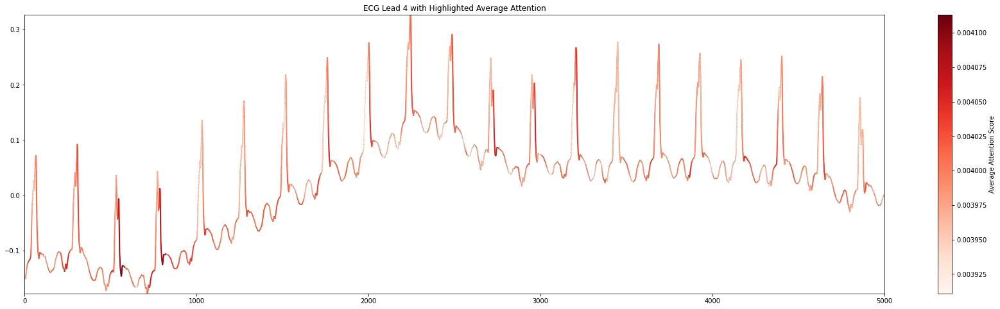

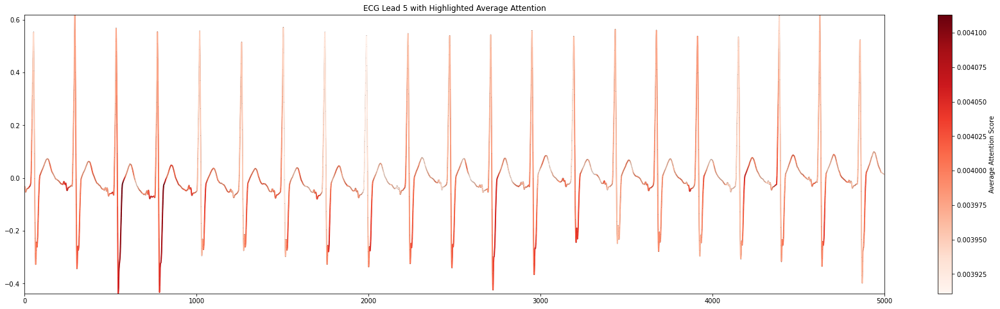

...

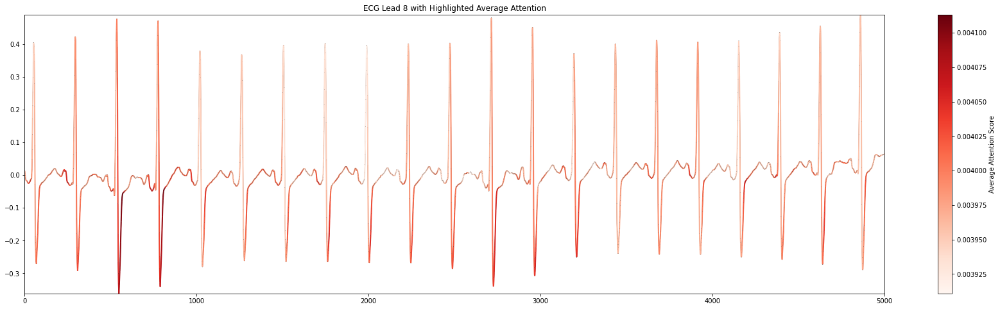

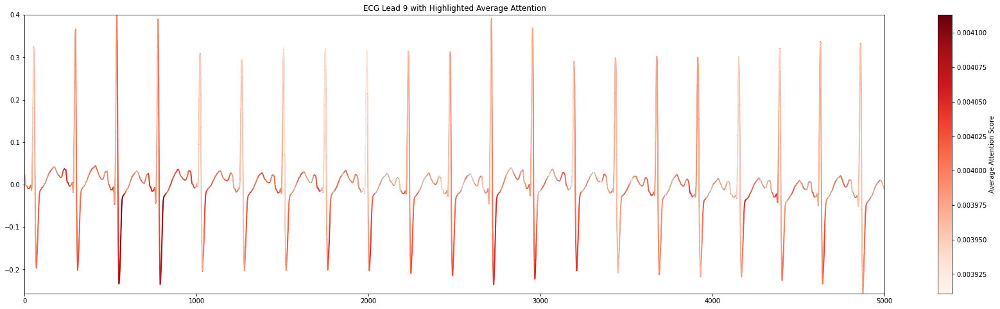

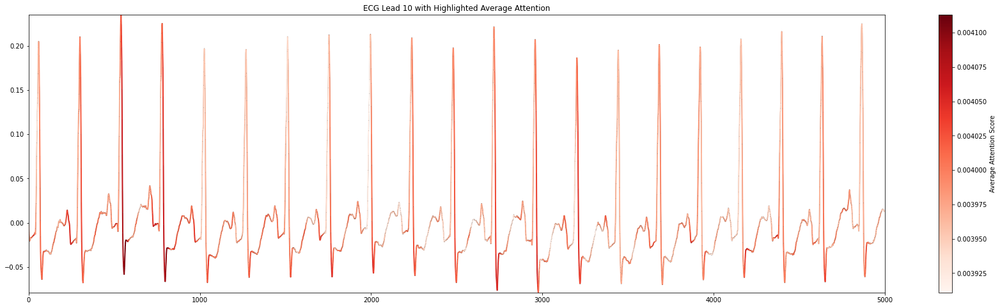

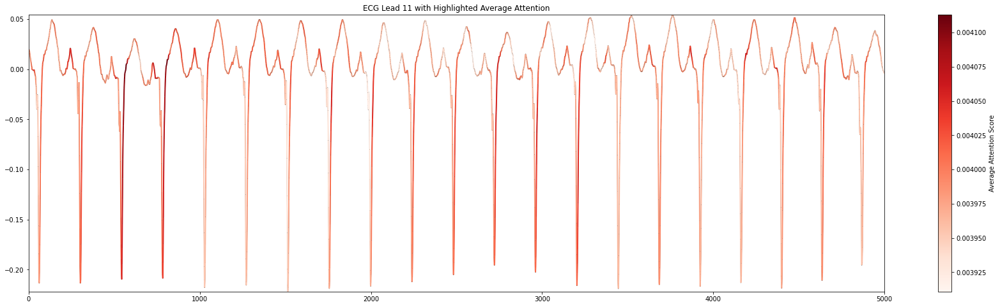

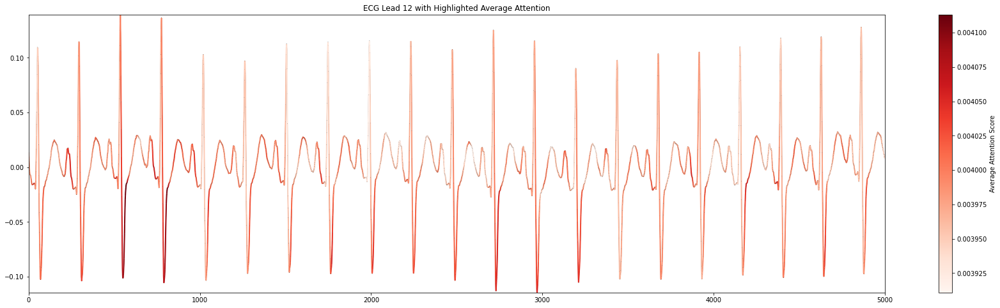

In [61]:
# 사용 예시

# ex_df = df[df['PatientID'] == 2260159].iloc[0]
# ex_df = df[df['PatientID'] == 2260188].iloc[4]
ex_df = df[df['PatientID'] == 2247933].iloc[2]
ex_df = df[df['PatientID'] == 2172946].iloc[8]
ecg_data = np.vstack([ex_df['WaveForm'][lead] for lead in sorted(ex_df['WaveForm'].keys())]).T  # (12, 5000) -> (5000, 12)
for i in range(12):
    model.plot_ecg_attention(ecg_data, vit, lead_index=i, weights_path='vit_best/')

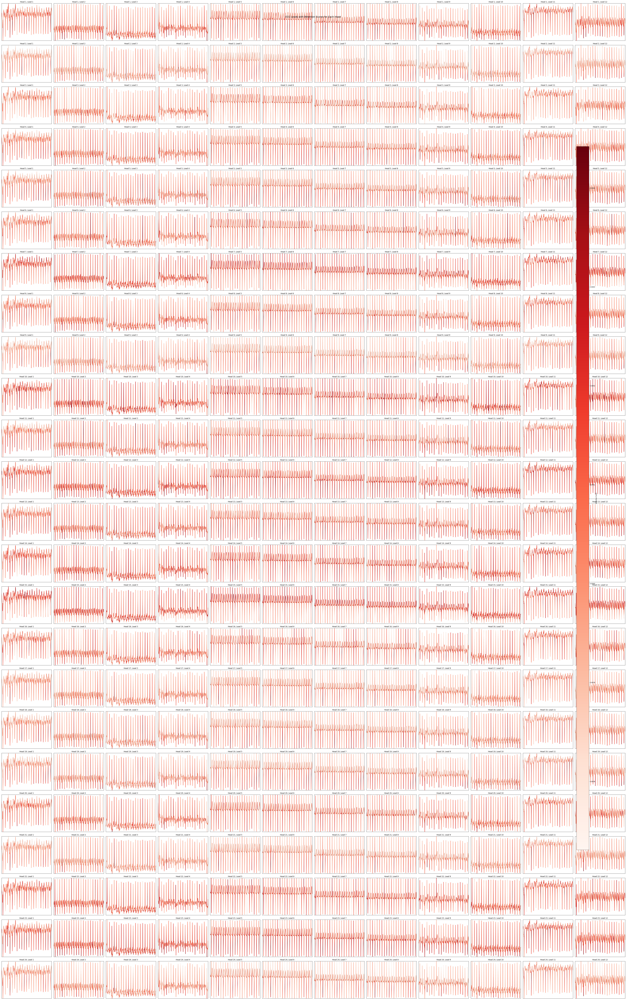

In [31]:
# 사용 예시
ecg_data = np.vstack([df['WaveForm'].iloc[0][lead] for lead in sorted(df['WaveForm'].iloc[0].keys())]).T  # (12, 5000) -> (5000, 12)
# for i in range(12):
#     model.plot_ecg_attention(ecg_data, vit, lead_index=i, weights_path='vit_best/')
model.plot_ecg_attention_per_head(ecg_data, vit, weights_path='vit_best/')

### 연구 3 - HF Hosp

In [63]:
### CMP 걸리지 않고 사망한 환자 제외
final_data = df

In [64]:
final_data.columns

Index(['index', 'PatientID', 'PatientAge', 'Gender', 'AcquisitionDate',
       'AcquisitionTime', 'VentricularRate', 'AtrialRate', 'PRInterval',
       'QRSDuration', 'QTInterval', 'QTCorrected', 'PAxis', 'RAxis', 'TAxis',
       'QRSCount', 'QOnset', 'QOffset', 'POnset', 'POffset', 'TOffset',
       'QTcFrederica', 'GlobalRR', 'QTRGGR', 'WaveformStartTime',
       'PharmaRRinterval', 'PharmaPPinterval', 'WaveForm', 'Global_RR', 'R',
       'S', 'R/S Ratio', 'ProcessedWaveForm', 'ID', 'Death', 'CMP', 'HF Hosp',
       'Death or HF Hosp', 'BirthD', 'Last_fu_date', 'Death date',
       'initial Echo', 'last echo', ' 50≤EF<55', '40≤EF<50', '30≤EF<40', '<30',
       'CMP_date', 'Hosp_date', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi', 'Age', 'DateTime'],
      dtype='object')

In [65]:
cmp = df[df['CMP'] == 1]
non_cmp = df[df['CMP'] == 0]

In [66]:
### CMP 걸리지 않고 사망한 환자 제외
final_data = df
dead_with_no_cmp = final_data[(final_data['CMP'] == 1) & (final_data['HF Hosp'] == 0)].PatientID.unique()
# final_data = final_data[~final_data['PatientID'].isin(dead_with_no_cmp)]


In [67]:
len(dead_with_no_cmp)

313

In [68]:
cmp = cmp[['PatientID','Age','AcquisitionDate','CMP_date','WaveForm','HF Hosp','Hosp_date','ProcessedWaveForm','Gender', 'scoliosis OP', 'Vent','Death date','Death or HF Hosp',
       # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker','digoxin', 'Entresto']]
           'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

In [69]:
cmp.columns

Index(['PatientID', 'Age', 'AcquisitionDate', 'CMP_date', 'WaveForm',
       'HF Hosp', 'Hosp_date', 'ProcessedWaveForm', 'Gender', 'scoliosis OP',
       'Vent', 'Death date', 'Death or HF Hosp', 'Arrhythmia', 'BB', 'ARB ',
       'ACEi'],
      dtype='object')

In [70]:
# 각 검사별로 cmp 발병 후 몇 개월 지난 시점의 검사인지 정의
import pandas as pd
def convert_to_datetime(val):
    try:
        return pd.to_datetime(val, errors='raise')
    except (ValueError, TypeError):
        return val


cmp['AcquisitionDate'] = pd.to_datetime(cmp['AcquisitionDate'], errors='coerce')
cmp['CMP_date'] = pd.to_datetime(cmp['CMP_date'], errors='coerce')
cmp['Hosp_date'] = pd.to_datetime(cmp['Hosp_date'], errors='coerce')
cmp['Death date'] = pd.to_datetime(cmp['Death date'], errors='coerce')

cmp['AcquisitionDate'] = cmp['AcquisitionDate'].apply(convert_to_datetime)
cmp['CMP_date'] = cmp['CMP_date'].apply(convert_to_datetime)
cmp['Hosp_date'] = cmp['Hosp_date'].apply(convert_to_datetime)
cmp['Death date'] = cmp['Death date'].apply(convert_to_datetime)

duration = []
for i in range(len(cmp)):
    duration.append((cmp['AcquisitionDate'].iloc[i] - cmp['CMP_date'].iloc[i]).days/30)

cmp['Duration'] = duration

In [71]:
cmp_dead = cmp[cmp['HF Hosp'] == 1]
cmp_live = cmp[cmp['HF Hosp'] == 0]

In [72]:
death_duration = []
for i in range(len(cmp_dead)):
    death_duration.append((cmp_dead['Hosp_date'].iloc[i] - cmp_dead['CMP_date'].iloc[i]).days/30)

cmp_dead['Hosp Duration'] = death_duration
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,Hosp Duration
2,2260375,3.0,2004-12-09,2013-02-01,"{'I': [0.082, 0.082, 0.082, 0.082, 0.082, 0.08...",1.0,2022-08-14,"{'I': [0.005546101694525797, 0.005843131557909...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,-99.200000,116.033333
13,2226404,11.0,2005-01-25,2004-02-10,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.028,...",1.0,2018-01-26,"{'I': [-0.00020565907829224136, -0.00034107055...",MALE,NaN,1,NaT,1.0,1.0,1.0,1.0,1.0,11.666667,169.966667
38,2204390,8.0,2006-03-07,2010-03-30,"{'I': [0.005, 0.0025005, 1.0002001e-06, -0.001...",1.0,2021-01-29,"{'I': [0.004522758277551266, 0.002916253943628...",MALE,0.0,NaN,2021-06-06,1.0,1.0,1.0,NaN,1.0,-49.466667,131.933333
54,2260375,5.0,2006-09-12,2013-02-01,"{'I': [-0.095, -0.0930004, -0.0910008, -0.0890...",1.0,2022-08-14,"{'I': [-0.004608647450789895, -0.0037725165403...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,-77.800000,116.033333
62,2214141,15.0,2006-10-31,2001-06-20,"{'I': [0.012, 0.0110002, 0.0100004, 0.0090006,...",1.0,2015-12-17,"{'I': [0.0002442986308389916, -0.0001502037309...",MALE,NaN,NaN,NaT,1.0,1.0,1.0,NaN,1.0,65.300000,176.433333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4364,2260375,20.0,2022-04-27,2013-02-01,"{'I': [-0.024, -0.024, -0.024, -0.024, -0.024,...",1.0,2022-08-14,"{'I': [-0.0015668875517147207, -0.001577754181...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,112.400000,116.033333
4374,2247034,23.0,2022-05-06,2016-01-12,"{'I': [0.0, 0.0, 0.0, 0.0, 0.002, 0.002, 0.002...",1.0,2017-04-20,"{'I': [0.0019088024063058763, 0.00220552506222...",MALE,NaN,NaN,NaT,1.0,NaN,1.0,1.0,1.0,76.866667,15.466667
4380,2480604,14.0,2022-05-10,2019-11-11,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.005,...",1.0,2023-05-09,"{'I': [-0.001275737715628749, -0.0024782728329...",MALE,NaN,NaN,NaT,1.0,1.0,1.0,1.0,NaN,30.366667,42.500000
4425,2547595,17.0,2022-06-05,2014-01-15,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1.0,2021-02-17,"{'I': [-0.003243415944593691, -0.0030464845567...",NaN,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,102.100000,86.333333


In [73]:
cmp_dead = cmp_dead[(cmp_dead['Hosp Duration']< 120) & (cmp_dead['Duration']< 12) &  (cmp_dead['Duration']> -12)]
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,Hosp Duration
113,2333940,16.0,2008-01-22,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,"{'I': [0.0011294540406437113, 0.00051485791330...",MALE,NaN,NaN,2008-05-02,1.0,NaN,NaN,NaN,NaN,0.000000,0.000000
117,2179467,22.0,2008-01-31,2007-11-27,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,"{'I': [-0.0003186227741226196, -2.742432406344...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,2.166667,58.533333
119,2179467,22.0,2008-03-03,2007-11-27,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,"{'I': [0.009460313971235966, 0.009458485106385...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,3.233333,58.533333
132,2333940,17.0,2008-05-03,2008-01-22,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,"{'I': [0.00016197699425042183, 0.0006573546542...",MALE,NaN,NaN,2008-05-02,1.0,NaN,NaN,NaN,NaN,3.400000,0.000000
144,2179467,22.0,2008-06-02,2007-11-27,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,"{'I': [-0.0002833051165457272, -0.000442725883...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,6.266667,58.533333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3419,2577394,8.0,2020-10-26,2020-10-21,"{'I': [0.0, 0.0, 0.0, 0.0, -0.004, -0.006, -0....",1.0,2020-10-21,"{'I': [-0.0049387748083805005, -0.004632701430...",MALE,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,0.166667,0.000000
3423,2577394,8.0,2020-10-27,2020-10-21,"{'I': [0.012, 0.012, 0.012, 0.012, 0.01, 0.01,...",1.0,2020-10-21,"{'I': [0.0005896723358314577, 0.00041888538266...",MALE,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,0.200000,0.000000
3438,2577394,8.0,2020-11-05,2020-10-21,"{'I': [0.002, 0.002, 0.002, 0.002, 0.0, 0.0, 0...",1.0,2020-10-21,"{'I': [0.0009999058918819682, 0.00091641437816...",MALE,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,0.500000,0.000000
3498,2577394,8.0,2020-12-07,2020-10-21,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",1.0,2020-10-21,"{'I': [-0.0013173373824286712, -0.001341464681...",MALE,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,1.566667,0.000000


In [74]:
cmp_live = cmp_live[(cmp_live['Duration']< 12) &  (cmp_live['Duration']> -12)]
cmp_live

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration
4,2239346,9.0,2005-01-11,2005-01-11,"{'I': [0.052, 0.0495005, 0.047001, 0.044501502...",0.0,NaT,"{'I': [0.004514198748816069, 0.003194146326561...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,NaN,0.000000
5,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333
6,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333
7,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000
8,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4396,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,1.0,1.0,5.866667
4402,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,0.000000
4416,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,6.433333
4421,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,1.0,0.000000


In [75]:
cmp_dead['Label'] =[1]*len(cmp_dead)
cmp_live['Label'] = [0]*len(cmp_live)

In [76]:
tot_df = pd.concat((cmp_dead,cmp_live), ignore_index=True)
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,Hosp Duration,Label
0,2333940,16.0,2008-01-22,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,"{'I': [0.0011294540406437113, 0.00051485791330...",MALE,NaN,NaN,2008-05-02,1.0,NaN,NaN,NaN,NaN,0.000000,0.000000,1
1,2179467,22.0,2008-01-31,2007-11-27,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,"{'I': [-0.0003186227741226196, -2.742432406344...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,2.166667,58.533333,1
2,2179467,22.0,2008-03-03,2007-11-27,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,"{'I': [0.009460313971235966, 0.009458485106385...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,3.233333,58.533333,1
3,2333940,17.0,2008-05-03,2008-01-22,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,"{'I': [0.00016197699425042183, 0.0006573546542...",MALE,NaN,NaN,2008-05-02,1.0,NaN,NaN,NaN,NaN,3.400000,0.000000,1
4,2179467,22.0,2008-06-02,2007-11-27,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,"{'I': [-0.0002833051165457272, -0.000442725883...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,6.266667,58.533333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,1.0,1.0,5.866667,NaN,0
744,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,0.000000,NaN,0
745,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,6.433333,NaN,0
746,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [77]:
tot_df['Label'].value_counts()

0    635
1    113
Name: Label, dtype: int64

In [ ]:


# PatientID별로 데이터 나누기
unique_patient_ids = total_data['PatientID'].unique()
train_ids, test_ids = train_test_split(unique_patient_ids, test_size=0.1, random_state=42)

train_df = total_data[total_data['PatientID'].isin(train_ids)]
test_df = total_data[total_data['PatientID'].isin(test_ids)]

# 데이터 전처리 함수 정의
def preprocess_data(df):
    data_list = []
    for i in range(len(df)):
        d = df[waveform].iloc[i]
        if len(d) > 12:
            keys_to_exclude = {'V3R', 'V4R', 'V7'}
            filtered_dict = {key: value for key, value in d.items() if key not in keys_to_exclude}
        else:
            filtered_dict = d

        single_data = np.vstack(filtered_dict.values())
        if single_data.shape != (12, 5000):
            array_2500 = single_data
            x_2500 = np.linspace(0, 12, single_data.shape[1])
            x_5000 = np.linspace(0, 12, 5000)
            linear_interpolator = interp1d(x_2500, array_2500, kind='linear')
            array_5000 = linear_interpolator(x_5000)
            data_list.append(array_5000)
        else:
            data_list.append(single_data)
    return np.array(data_list)

# 데이터 전처리 수행
X_train = preprocess_data(train_df)
y_train = np.array(train_df['Label'])
X_test = preprocess_data(test_df)
y_test = np.array(test_df['Label'])
print(X_train.shape)
print(y_train.shape)

# 데이터 정규화 (각 채널별로)
scaler = StandardScaler()

X_train = X_train.reshape(-1, X_train.shape[-1])
X_train = scaler.fit_transform(X_train)
X_train = X_train.reshape(-1, 12, 5000)

X_test = X_test.reshape(-1, X_test.shape[-1])
X_test = scaler.transform(X_test)
X_test = X_test.reshape(-1, 12, 5000)

# Convert numpy arrays to PyTorch tensors and move to device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
X_train = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.float32).to(device)

(105, 12, 5000)
(105,)


In [55]:
test_df['Label'].value_counts()

1.0    8
Name: Label, dtype: int64

In [54]:
train_df['Label'].value_counts()


1.0    105
Name: Label, dtype: int64

In [44]:
# model.CNN_MODEL(tot_df, epoch = 100, batch_size = 32)
model.CNN_MODEL(tot_df, epoch = 100, batch_size = 32, waveform='WaveForm')
# model.CNN_MODEL(tot_df, epoch = 200, batch_size = 32)
# model.CNN_MODEL(tot_df, epoch = 200, batch_size = 64)

(105, 12, 5000)
(105,)
Epoch [10/100], Train Loss: 0.0000
Epoch [20/100], Train Loss: 0.0000
Epoch [30/100], Train Loss: 0.0000
Epoch [40/100], Train Loss: 0.0000
Epoch [50/100], Train Loss: 0.0000
Epoch [60/100], Train Loss: 0.0000
Epoch [70/100], Train Loss: 0.0000
Epoch [80/100], Train Loss: 0.0000
Epoch [90/100], Train Loss: 0.0000
Epoch [100/100], Train Loss: 0.0000
Training complete.


ValueError: Only one class present in y_true. ROC AUC score is not defined in that case.

#### Tabular Added

In [19]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Hosp Duration,Label
0,2333940,16.0,2008-01-22,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,"{'I': [0.0011294540406437113, 0.00051485791330...",MALE,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,1
1,2179467,22.0,2008-01-31,2007-11-27,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,"{'I': [-0.0003186227741226196, -2.742432406344...",MALE,NaN,1,1.0,1.0,NaN,1.0,2.166667,58.533333,1
2,2179467,22.0,2008-03-03,2007-11-27,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,"{'I': [0.009460313971235966, 0.009458485106385...",MALE,NaN,1,1.0,1.0,NaN,1.0,3.233333,58.533333,1
3,2333940,17.0,2008-05-03,2008-01-22,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,"{'I': [0.00016197699425042183, 0.0006573546542...",MALE,NaN,NaN,NaN,NaN,NaN,NaN,3.400000,0.000000,1
4,2179467,22.0,2008-06-02,2007-11-27,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,"{'I': [-0.0002833051165457272, -0.000442725883...",MALE,NaN,1,1.0,1.0,NaN,1.0,6.266667,58.533333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667,NaN,0
744,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000,NaN,0
745,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,6.433333,NaN,0
746,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [20]:
table = tot_df[['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [21]:
concat_table = pd.merge(tot_df[['PatientID','AcquisitionDate','WaveForm','ProcessedWaveForm','Label']], table, how='left', on=['PatientID','AcquisitionDate'])

In [22]:
concat_table

,PatientID,AcquisitionDate,WaveForm,ProcessedWaveForm,Label,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2333940,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...","{'I': [0.0011294540406437113, 0.00051485791330...",1,0.350,1,0,0,0,0,0,0
1,2179467,2008-01-31,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...","{'I': [-0.0003186227741226196, -2.742432406344...",1,0.500,1,0,1,1,1,0,1
2,2179467,2008-03-03,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...","{'I': [0.009460313971235966, 0.009458485106385...",1,0.500,1,0,1,1,1,0,1
3,2333940,2008-05-03,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...","{'I': [0.00016197699425042183, 0.0006573546542...",1,0.375,1,0,0,0,0,0,0
4,2179467,2008-06-02,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...","{'I': [-0.0002833051165457272, -0.000442725883...",1,0.500,1,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...","{'I': [-0.0009398949308504023, -0.000745406959...",0,0.325,1,0,0,0,1,1,1
744,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....","{'I': [0.0010573135514592076, -3.8200843735528...",0,0.275,1,0,0,0,1,0,1
745,2389969,2022-05-30,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...","{'I': [0.0017843614878264428, 0.00265179843581...",0,0.325,1,0,0,0,1,0,1
746,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....","{'I': [0.0010583006490491778, 0.00131258523873...",0,0.350,1,0,0,0,0,0,1


In [23]:
concat_table.columns

Index(['PatientID', 'AcquisitionDate', 'WaveForm', 'ProcessedWaveForm',
       'Label', 'Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi'],
      dtype='object')

In [59]:
waveform = 'WaveForm'
tabular_features = ['scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']#'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']
batch_size = 32
epoch = 200
model.CNN_MODEL_TABULAR_ADDED(concat_table, batch_size, epoch, waveform, tabular_features)


(584, 12, 5000)
(584,)
Epoch [10/200], Train Loss: 0.0275
Epoch [20/200], Train Loss: 0.0148
Epoch [30/200], Train Loss: 0.0302
Epoch [40/200], Train Loss: 0.0234
Epoch [50/200], Train Loss: 0.0035
Epoch [60/200], Train Loss: 0.0645
Epoch [70/200], Train Loss: 0.1400
Epoch [80/200], Train Loss: 0.0127
Epoch [90/200], Train Loss: 0.0320
Epoch [100/200], Train Loss: 0.0009
Epoch [110/200], Train Loss: 0.0026
Epoch [120/200], Train Loss: 0.0103
Epoch [130/200], Train Loss: 0.0164
Epoch [140/200], Train Loss: 0.0203
Epoch [150/200], Train Loss: 0.0429
Epoch [160/200], Train Loss: 0.0309
Epoch [170/200], Train Loss: 0.0038
Epoch [180/200], Train Loss: 0.0019
Epoch [190/200], Train Loss: 0.0026
Epoch [200/200], Train Loss: 0.0014
Training complete.
Test Accuracy: 0.8963
Test ROC AUC Score: 0.7546


#### 사람별

In [24]:
import model

In [25]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Duration,Hosp Duration,Label
0,2333940,16.0,2008-01-22,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,"{'I': [0.0011294540406437113, 0.00051485791330...",MALE,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,1
1,2179467,22.0,2008-01-31,2007-11-27,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,"{'I': [-0.0003186227741226196, -2.742432406344...",MALE,NaN,1,1.0,1.0,NaN,1.0,2.166667,58.533333,1
2,2179467,22.0,2008-03-03,2007-11-27,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,"{'I': [0.009460313971235966, 0.009458485106385...",MALE,NaN,1,1.0,1.0,NaN,1.0,3.233333,58.533333,1
3,2333940,17.0,2008-05-03,2008-01-22,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,"{'I': [0.00016197699425042183, 0.0006573546542...",MALE,NaN,NaN,NaN,NaN,NaN,NaN,3.400000,0.000000,1
4,2179467,22.0,2008-06-02,2007-11-27,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,"{'I': [-0.0002833051165457272, -0.000442725883...",MALE,NaN,1,1.0,1.0,NaN,1.0,6.266667,58.533333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaN,1.0,1.0,1.0,5.866667,NaN,0
744,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,0.000000,NaN,0
745,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,NaN,NaN,1.0,NaN,1.0,6.433333,NaN,0
746,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaN,NaN,NaN,1.0,0.000000,NaN,0


In [26]:
tot_df
# df = filtered_df
dff = pd.DataFrame({'PatientID':[],'AcquisitionDate':[],'WaveForm':[],'Label':[],'HospDate':[]})
label = []
WaveForm = []
patient_id = []
date = []
hosp_date=[]
# age = []
unique_patients = tot_df.PatientID.unique().tolist()
for patient in unique_patients:
    a = tot_df[tot_df['PatientID'] == patient]
    for i in range(len(a)):
        label.append(a['HF Hosp'].unique()[0])
        date.append(a['AcquisitionDate'].iloc[i])
        WaveForm.append(a['WaveForm'].iloc[i]) # WaveForm vs ProcessedWaveForm 결정
        patient_id.append(a['PatientID'].iloc[i])
        # age.append(a['Age'].iloc[i])
        hosp_date.append(tot_df[tot_df['PatientID'] == patient]['Hosp_date'].iloc[0])
dff['WaveForm'] = WaveForm
dff['AcquisitionDate'] = date
dff['HospDate'] = hosp_date
dff['Label'] = label
dff['PatientID'] = patient_id
# dff['Age'] = age

In [76]:

    # lstm_input_size = 12  # Number of features (channels)
    # hidden_size = 64  # Number of LSTM units
    # lstm_output_size = 32  # Embedding size
    # num_epochs = 20
    
    # batch_size = 8  # Batch size for DataLoader
    # num_epochs_cnn = 100  # Number of epochs for CNN training


# def LSTM_CNN_MODEL(tot_df, lstm_input_size, hidden_size, lstm_output_size,num_epochs,batch_size,num_epochs_cnn):

In [64]:
# tot_df-> 사람별로 바꾸기

In [108]:
def LSTM_CNN_MODEL(tot_df, waveform, lstm_input_size, hidden_size, lstm_output_size, num_epochs, batch_size, num_epochs_cnn):

    total_data = tot_df

    # Split data by PatientID
    unique_patient_ids = total_data['PatientID'].unique()
    train_ids, test_ids = train_test_split(unique_patient_ids, test_size=0.1, random_state=42)

    train_df = total_data[total_data['PatientID'].isin(train_ids)]
    test_df = total_data[total_data['PatientID'].isin(test_ids)]

    # Data preprocessing function
    def preprocess_data(df):
        data_dict = {}
        labels = {}

        for patient_id in df['PatientID'].unique():
            patient_data = df[df['PatientID'] == patient_id]
            data_list = []

            for i in range(len(patient_data)):
                d = patient_data[waveform].iloc[i]

                if len(d) > 12:
                    keys_to_exclude = {'V3R', 'V4R', 'V7'}
                    filtered_dict = {key: value for key, value in d.items() if key not in keys_to_exclude}
                else:
                    filtered_dict = d

                single_data = np.vstack(filtered_dict.values())
                if single_data.shape != (12, 5000):
                    array_2500 = single_data
                    x_2500 = np.linspace(0, 12, single_data.shape[1])
                    x_5000 = np.linspace(0, 12, 5000)
                    linear_interpolator = interp1d(x_2500, array_2500, kind='linear')
                    array_5000 = linear_interpolator(x_5000)
                    data_list.append(array_5000.astype(np.float32))  # Ensure data is float32
                else:
                    data_list.append(single_data.astype(np.float32))  # Ensure data is float32

            data_dict[patient_id] = np.array(data_list, dtype=np.float32)
            labels[patient_id] = patient_data['Label'].values[0]

        return data_dict, labels

    # Preprocess data
    train_data, train_labels = preprocess_data(train_df)
    test_data, test_labels = preprocess_data(test_df)

    # Normalize data (channel-wise)
    scaler = StandardScaler()

    for patient_id in train_data.keys():
        num_ecgs = train_data[patient_id].shape[0]
        train_data[patient_id] = train_data[patient_id].reshape(-1, train_data[patient_id].shape[-1])
        train_data[patient_id] = scaler.fit_transform(train_data[patient_id])
        train_data[patient_id] = train_data[patient_id].reshape(num_ecgs, 5000, 12)

    for patient_id in test_data.keys():
        num_ecgs = test_data[patient_id].shape[0]
        test_data[patient_id] = test_data[patient_id].reshape(-1, test_data[patient_id].shape[-1])
        test_data[patient_id] = scaler.transform(test_data[patient_id])
        test_data[patient_id] = test_data[patient_id].reshape(num_ecgs, 5000, 12)

    # Define a custom dataset for loading ECG data
    class ECGDataset(Dataset):
        def __init__(self, data_dict, labels):
            self.data_dict = data_dict
            self.labels = labels
            self.patient_ids = list(data_dict.keys())

        def __len__(self):
            return len(self.patient_ids)

        def __getitem__(self, idx):
            patient_id = self.patient_ids[idx]
            ecgs = self.data_dict[patient_id]
            label = self.labels[patient_id]
            return torch.tensor(ecgs, dtype=torch.float32), torch.tensor(label, dtype=torch.long)

    # Create DataLoader
    lstm_batch_size = 1
    train_dataset = ECGDataset(train_data, train_labels)
    train_loader = DataLoader(train_dataset, batch_size=lstm_batch_size, shuffle=True)

    test_dataset = ECGDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=lstm_batch_size, shuffle=False)

    # Define the LSTM model for embedding
    class LSTMEmbedder(nn.Module):
        def __init__(self, input_size, hidden_size, output_size):
            super(LSTMEmbedder, self).__init__()
            self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
            self.fc = nn.Linear(hidden_size, output_size)

        def forward(self, x):
            lstm_out, _ = self.lstm(x)
            lstm_out = lstm_out[:, -1, :]  # Use the output of the last time step
            embedding = self.fc(lstm_out)
            return embedding

    # Initialize model
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    lstm_embedder = LSTMEmbedder(lstm_input_size, hidden_size, lstm_output_size).to(device)

    # Define loss and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(lstm_embedder.parameters(), lr=0.001)

    # Train the LSTM model
    for epoch in range(num_epochs):
        lstm_embedder.train()

        for X_batch, y_batch in train_loader:
            X_batch = X_batch.squeeze(0).to(device)  # Remove batch dimension
            y_batch = y_batch.to(device)
            optimizer.zero_grad()

            embeddings = lstm_embedder(X_batch)
            outputs = embeddings.mean(dim=0)  # Mean of all embeddings for the patient

            loss = criterion(outputs.unsqueeze(0), y_batch)
            loss.backward()
            optimizer.step()

        print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}')

    # Extract embeddings for the training and test data
    def extract_embeddings(data_loader, model):
        embeddings = []
        labels = []
        model.eval()
        with torch.no_grad():
            for X_batch, y_batch in data_loader:
                X_batch = X_batch.squeeze(0).to(device)
                y_batch = y_batch.to(device)
                patient_embeddings = model(X_batch)
                patient_embedding = patient_embeddings.mean(dim=0)
                embeddings.append(patient_embedding.cpu().numpy())
                labels.append(y_batch.cpu().numpy())
        return np.array(embeddings, dtype=np.float32), np.array(labels)

    train_embeddings, train_labels_array = extract_embeddings(train_loader, lstm_embedder)
    test_embeddings, test_labels_array = extract_embeddings(test_loader, lstm_embedder)

    # Print the shape of the embeddings and labels
    print(f'Train embeddings shape: {train_embeddings.shape}')
    print(f'Train labels shape: {train_labels_array.shape}')
    print(f'Test embeddings shape: {test_embeddings.shape}')
    print(f'Test labels shape: {test_labels_array.shape}')

    # 설정 변수
    input_size = lstm_output_size  # Embedding size from LSTM
    batch_size = batch_size
    num_epochs_cnn = num_epochs_cnn

    # Define the CNN model for prediction
    class ComplexCNNModel(nn.Module):
        def __init__(self):
            super(ComplexCNNModel, self).__init__()
            self.conv1 = nn.Conv1d(in_channels=1, out_channels=64, kernel_size=5, padding=2)
            self.bn1 = nn.BatchNorm1d(64)
            self.conv2 = nn.Conv1d(in_channels=64, out_channels=128, kernel_size=5, padding=2)
            self.bn2 = nn.BatchNorm1d(128)
            self.conv3 = nn.Conv1d(in_channels=128, out_channels=256, kernel_size=3, padding=1)
            self.bn3 = nn.BatchNorm1d(256)
            self.pool = nn.MaxPool1d(kernel_size=2, stride=2, padding=0)
            self.fc1 = nn.Linear(256 * (input_size // 8), 256)  # Adjust based on the new input size
            self.fc2 = nn.Linear(256, 1)
            self.dropout = nn.Dropout(0.5)
            self.relu = nn.ReLU()

        def forward(self, x):
            x = self.pool(self.relu(self.bn1(self.conv1(x))))
            x = self.pool(self.relu(self.bn2(self.conv2(x))))
            x = self.pool(self.relu(self.bn3(self.conv3(x))))
            x = x.view(x.size(0), -1)  # Use x.size(0) to ensure the correct batch size
            x = self.dropout(self.relu(self.fc1(x)))
            x = self.fc2(x)
            return x

    # Initialize the CNN model
    cnn_model = ComplexCNNModel().to(device)

    # Define loss and optimizer
    cnn_criterion = nn.BCEWithLogitsLoss()
    cnn_optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)

    # Convert embeddings and labels to PyTorch tensors and create DataLoader
    train_embeddings_tensor = torch.tensor(train_embeddings, dtype=torch.float32).unsqueeze(1).to(device)  # Add channel dimension
    train_labels_tensor = torch.tensor(train_labels_array.squeeze(), dtype=torch.float32).to(device)  # Ensure labels are in the correct shape and type
    test_embeddings_tensor = torch.tensor(test_embeddings, dtype=torch.float32).unsqueeze(1).to(device)  # Add channel dimension
    test_labels_tensor = torch.tensor(test_labels_array.squeeze(), dtype=torch.float32).to(device)  # Ensure labels are in the correct shape and type

    train_embed_dataset = TensorDataset(train_embeddings_tensor, train_labels_tensor)
    train_embed_loader = DataLoader(train_embed_dataset, batch_size=batch_size, shuffle=True)

    test_embed_dataset = TensorDataset(test_embeddings_tensor, test_labels_tensor)
    test_embed_loader = DataLoader(test_embed_dataset, batch_size=batch_size, shuffle=False)

    # Train the CNN model
    for epoch in range(num_epochs_cnn):
        cnn_model.train()

        for X_batch, y_batch in train_embed_loader:
            cnn_optimizer.zero_grad()

            outputs = cnn_model(X_batch).squeeze(1)  # 모델 출력의 크기를 [batch_size]로 변경

            if y_batch.dim() > 1:  # 타겟 텐서가 2차원인 경우
                y_batch = y_batch.squeeze(1)  # 타겟 텐서를 1차원으로 변환

            loss = cnn_criterion(outputs, y_batch)  # 손실 계산
            loss.backward()
            cnn_optimizer.step()

        if (epoch + 1) % 10 == 0:
            print(f'CNN Epoch {epoch+1}/{num_epochs_cnn}, Loss: {loss.item():.3f}')

    # Evaluate the CNN model
    cnn_model.eval()
    with torch.no_grad():
        train_preds = []
        train_labels = []
        for X_batch, y_batch in train_embed_loader:
            train_outputs = cnn_model(X_batch).squeeze(1)
            train_preds.append(train_outputs)
            train_labels.append(y_batch)

        train_preds = torch.cat(train_preds)
        train_labels = torch.cat(train_labels)
        train_pred = torch.sigmoid(train_preds).cpu().numpy() > 0.5  # Use sigmoid for binary classification
        train_accuracy = accuracy_score(train_labels.cpu(), train_pred)
        train_roc_auc = roc_auc_score(train_labels.cpu(), torch.sigmoid(train_preds).cpu())

        test_preds = []
        test_labels = []
        for X_batch, y_batch in test_embed_loader:
            test_outputs = cnn_model(X_batch).squeeze(1)
            test_preds.append(test_outputs)
            test_labels.append(y_batch)

        test_preds = torch.cat(test_preds)
        test_labels = torch.cat(test_labels)
        test_pred = torch.sigmoid(test_preds).cpu().numpy() > 0.5  # Use sigmoid for binary classification
        test_accuracy = accuracy_score(test_labels.cpu(), test_pred)
        test_roc_auc = roc_auc_score(test_labels.cpu(), torch.sigmoid(test_preds).cpu())

    print(f'Train Accuracy: {train_accuracy:.3f}, Train ROC-AUC: {train_roc_auc:.3f}')
    print(f'Test Accuracy: {test_accuracy:.3f}, Test ROC-AUC: {test_roc_auc:.3f}')


In [109]:
model.LSTM_CNN_MODEL(dff,
                    lstm_input_size = 12,
                    num_epochs_cnn = 100,
                    batch_size = 64,
                    num_epochs = 20,
                    hidden_size = 128,
                    lstm_output_size = 64,
                    waveform='WaveForm')

Epoch 1/20, Loss: 0.11796654760837555
Epoch 2/20, Loss: 0.11494129151105881
Epoch 3/20, Loss: 0.09763813763856888
Epoch 4/20, Loss: 0.15445764362812042
Epoch 5/20, Loss: 0.0688718929886818
Epoch 6/20, Loss: 0.028009938076138496
Epoch 7/20, Loss: 0.16909970343112946
Epoch 8/20, Loss: 0.2163500189781189
Epoch 9/20, Loss: 0.03449214994907379
Epoch 10/20, Loss: 3.131972312927246
Epoch 11/20, Loss: 0.14628106355667114
Epoch 12/20, Loss: 0.04450679570436478
Epoch 13/20, Loss: 0.024724455550312996
Epoch 14/20, Loss: 0.1349755823612213
Epoch 15/20, Loss: 0.07625683397054672
Epoch 16/20, Loss: 0.2034778892993927
Epoch 17/20, Loss: 0.08013561367988586
Epoch 18/20, Loss: 0.09395582228899002
Epoch 19/20, Loss: 0.08468058705329895
Epoch 20/20, Loss: 0.04410433769226074
Train embeddings shape: (257, 64)
Train labels shape: (257, 1)
Test embeddings shape: (29, 64)
Test labels shape: (29, 1)
CNN Epoch 10/100, Loss: 0.042
CNN Epoch 20/100, Loss: 0.082
CNN Epoch 30/100, Loss: 0.049
CNN Epoch 40/100, Los

#### 사람별 + tabular

In [27]:

table = tot_df[['scoliosis OP','Vent', 
# 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [28]:
concat_table = pd.merge(dff, table, how='left', on=['PatientID', 'AcquisitionDate'])

In [107]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, roc_auc_score
import numpy as np
from scipy.interpolate import interp1d
import pandas as pd
import model

# Usage:
tot_df = concat_table
waveform = 'WaveForm'
lstm_input_size = 12
mlp_input_size = 8


num_epochs_cnn = 100
batch_size = 32
num_epochs = 20
hidden_size = 64
lstm_output_size = 64
num_epochs = 20
mlp_hidden_size = 64
mlp_output_size = 64
tabular_features = ['Age','Gender','scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']
models = model.LSTM_CNN_MODEL_TABULAR_ADDED(tot_df, waveform, lstm_input_size, hidden_size, lstm_output_size, mlp_input_size, mlp_hidden_size, mlp_output_size, num_epochs, batch_size, num_epochs_cnn, tabular_features)
models.run()


Epoch 1/20, Loss: 0.03852328658103943
Epoch 2/20, Loss: 0.18768846988677979
Epoch 3/20, Loss: 0.054371222853660583
Epoch 4/20, Loss: 0.06143670901656151
Epoch 5/20, Loss: 0.07632608711719513
Epoch 6/20, Loss: 0.06368716806173325
Epoch 7/20, Loss: 0.05036686360836029
Epoch 8/20, Loss: 0.05716859921813011
Epoch 9/20, Loss: 0.10518384724855423
Epoch 10/20, Loss: 0.06996402144432068
Epoch 11/20, Loss: 0.0406588651239872
Epoch 12/20, Loss: 0.05720732733607292
Epoch 13/20, Loss: 0.06190968677401543
Epoch 14/20, Loss: 0.054209984838962555
Epoch 15/20, Loss: 0.1139116883277893
Epoch 16/20, Loss: 0.25657153129577637
Epoch 17/20, Loss: 0.20341981947422028
Epoch 18/20, Loss: 0.06606503576040268
Epoch 19/20, Loss: 0.051309071481227875
Epoch 20/20, Loss: 0.035773031413555145
MLP Epoch 1/20, Loss: 3.685915946960449
MLP Epoch 2/20, Loss: 3.4733121395111084
MLP Epoch 3/20, Loss: 3.3983826637268066
MLP Epoch 4/20, Loss: 2.892617702484131
MLP Epoch 5/20, Loss: 2.5443062782287598
MLP Epoch 6/20, Loss: 2.

In [118]:
tot_df

,PatientID,AcquisitionDate,WaveForm,Label,HospDate,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2333940,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,0.350,1,0,0,0,0,0,0
1,2333940,2008-05-03,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,0.375,1,0,0,0,0,0,0
2,2179467,2008-01-31,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
3,2179467,2008-03-03,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
4,2179467,2008-06-02,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2608828,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0.0,NaT,0.300,1,0,0,0,0,0,1
744,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,0.325,1,0,0,0,1,1,1
745,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,0.275,1,0,0,0,1,0,1
746,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,0.350,1,0,0,0,0,0,1


#### Vision Transformer

In [78]:
# 사용 예시
vit_patch_size=10
vit_hidden_size=768
vit_depth=12
vit_num_heads=12
vit_mlp_dim=256
df = tot_df

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=32, epochs=20, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

Epoch 1/20
19/19 [==============================] - 17s 539ms/step - loss: 0.8256 - roc_auc: 0.5081 - accuracy: 0.7586 - val_loss: 0.2792 - val_roc_auc: 0.2802 - val_accuracy: 0.9329
Epoch 2/20
19/19 [==============================] - 7s 377ms/step - loss: 0.6928 - roc_auc: 0.5364 - accuracy: 0.7945 - val_loss: 0.2691 - val_roc_auc: 0.3654 - val_accuracy: 0.9329
Epoch 3/20
19/19 [==============================] - 7s 376ms/step - loss: 0.4918 - roc_auc: 0.6480 - accuracy: 0.8151 - val_loss: 0.2814 - val_roc_auc: 0.3586 - val_accuracy: 0.9329
Epoch 4/20
19/19 [==============================] - 7s 376ms/step - loss: 0.4491 - roc_auc: 0.6726 - accuracy: 0.8271 - val_loss: 0.3680 - val_roc_auc: 0.3324 - val_accuracy: 0.9329
Epoch 5/20
19/19 [==============================] - 7s 379ms/step - loss: 0.3877 - roc_auc: 0.7700 - accuracy: 0.8356 - val_loss: 0.3006 - val_roc_auc: 0.4611 - val_accuracy: 0.9329
Epoch 6/20
19/19 [==============================] - 7s 378ms/step - loss: 0.3911 - roc_au

In [84]:
df = df_loaded
df[df['PatientID'] == 2247933]

,index,PatientID,PatientAge,Gender,AcquisitionDate,AcquisitionTime,VentricularRate,AtrialRate,PRInterval,QRSDuration,...,CMP_date,Hosp_date,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi,Age,DateTime
213,0,2247933,11.0,MALE,2009-02-10,16:17:00,98.0,98.0,158.0,86.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,11.0,2009-02-10 16:17:00
425,0,2247933,14.0,MALE,2011-05-13,16:11:00,84.0,84.0,144.0,98.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,13.0,2011-05-13 16:11:00
660,0,2247933,15.0,MALE,2012-11-02,10:43:00,77.0,77.0,134.0,106.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,15.0,2012-11-02 10:43:00
924,0,2247933,17.0,MALE,2014-03-31,14:41:00,85.0,85.0,162.0,98.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,16.0,2014-03-31 14:41:00
1058,0,2247933,17.0,MALE,2014-09-30,10:51:00,72.0,72.0,150.0,98.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,17.0,2014-09-30 10:51:00
1475,0,2247933,19.0,MALE,2016-03-14,13:14:00,75.0,75.0,170.0,100.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,18.0,2016-03-14 13:14:00
1813,0,2247933,19.0,MALE,2017-02-27,14:15:00,70.0,70.0,146.0,98.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,19.0,2017-02-27 14:15:00
2155,0,2247933,20.0,MALE,2018-02-19,14:09:00,74.0,74.0,182.0,92.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,20.0,2018-02-19 14:09:00
2472,0,2247933,21.0,MALE,2018-12-17,14:13:00,74.0,74.0,210.0,100.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,21.0,2018-12-17 14:13:00
2608,0,2247933,21.0,MALE,2019-03-18,09:56:00,87.0,87.0,194.0,98.0,...,2011-05-13,2020-03-02,NaN,NaN,NaN,1.0,NaN,1.0,21.0,2019-03-18 09:56:00


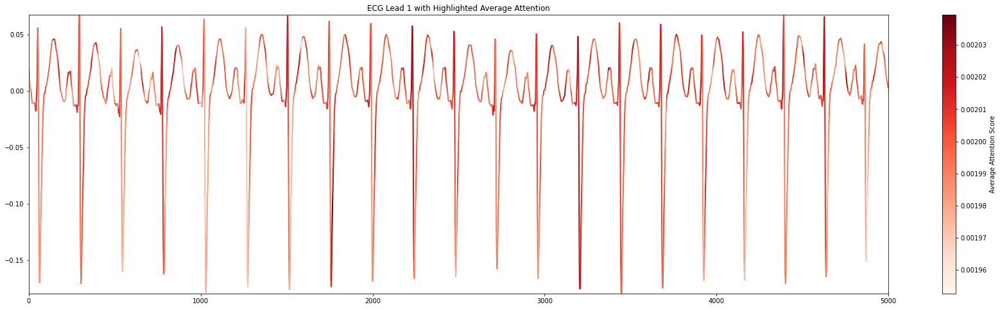

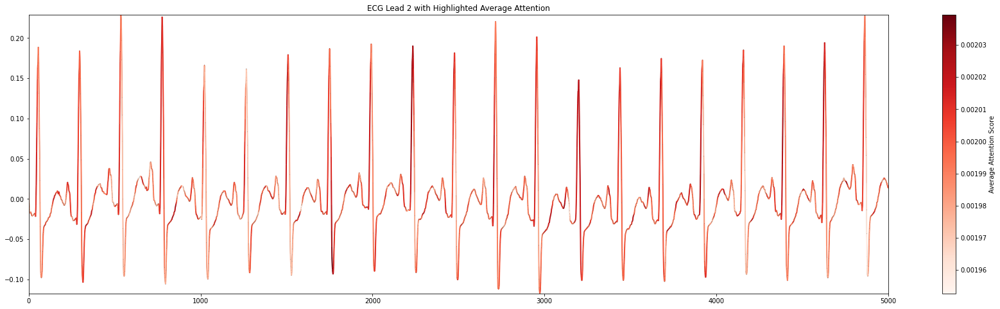

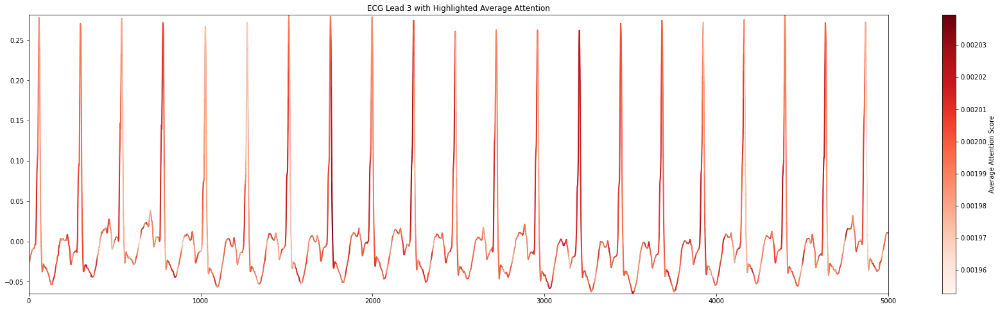

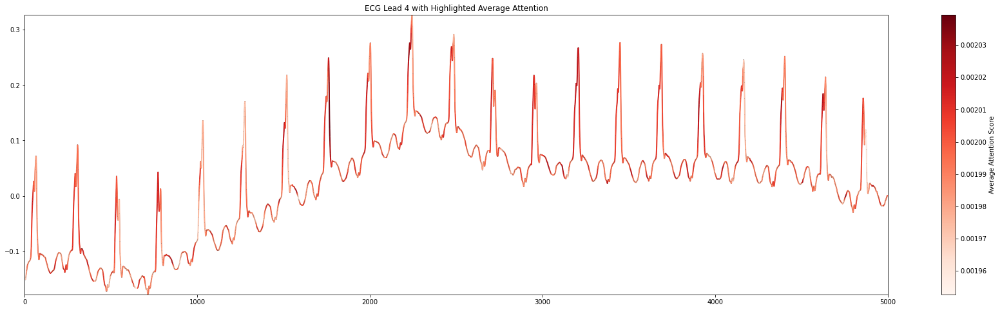

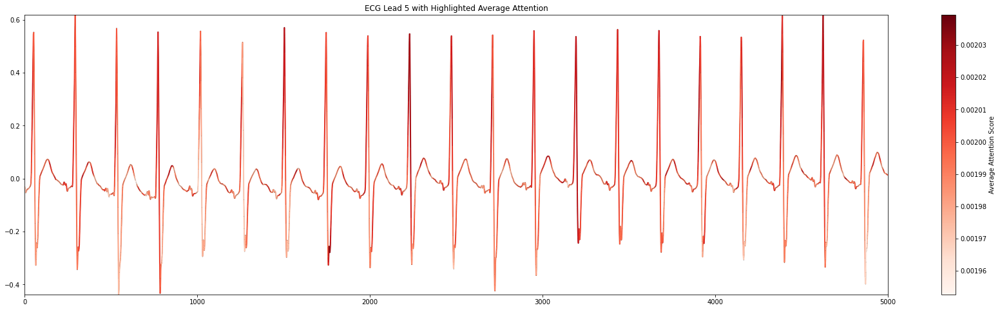

...

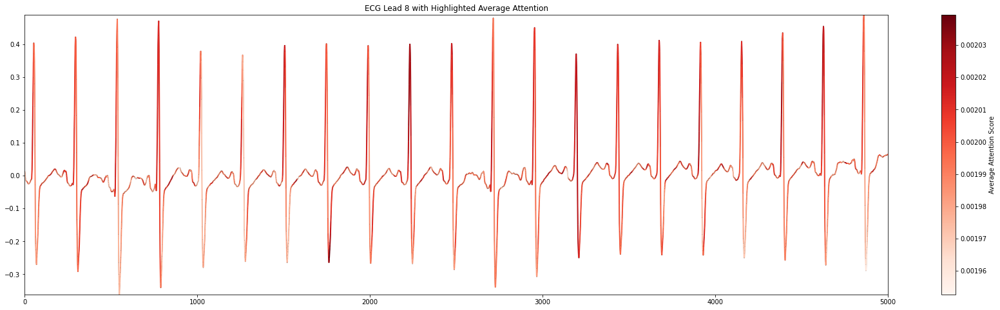

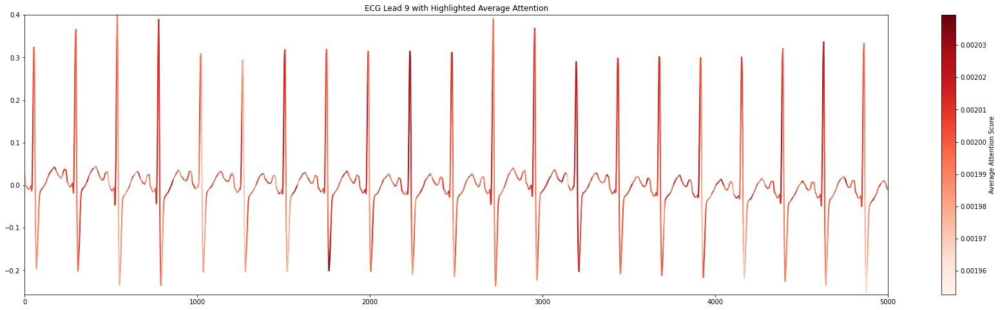

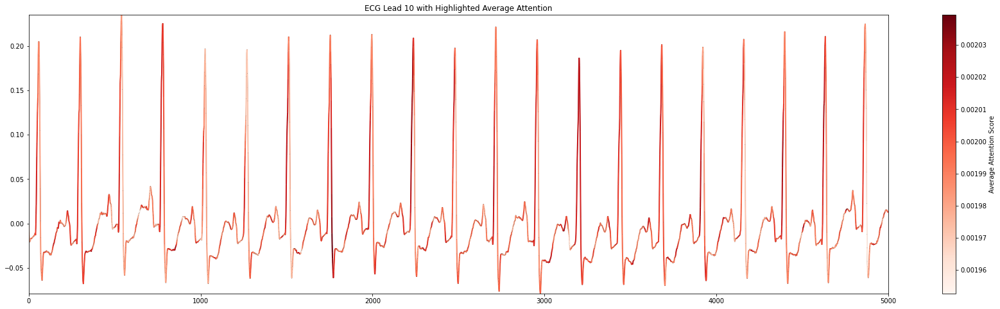

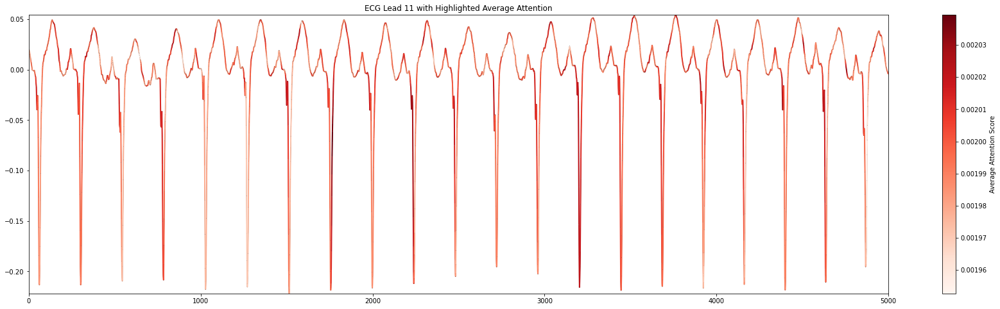

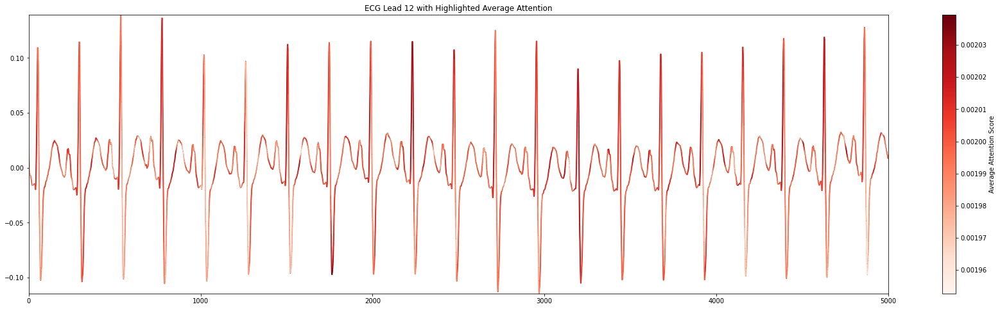

In [86]:
# 사용 예시
df = df_loaded
# ex_df = df[df['PatientID'] == 2260159].iloc[3]
# ex_df = df[df['PatientID'] == 2260188].iloc[4]
# ex_df = df[df['PatientID'] == 2247933].iloc[2]
ex_df = df[df['PatientID'] == 2172946].iloc[8]
ecg_data = np.vstack([ex_df['WaveForm'][lead] for lead in sorted(ex_df['WaveForm'].keys())]).T  # (12, 5000) -> (5000, 12)
for i in range(12):
    model.plot_ecg_attention(ecg_data, vit, lead_index=i, weights_path='vit_best/')

### 연구 4 - HF Hosp OR Death

In [67]:
### CMP 걸리지 않고 사망한 환자 제외
final_data = df

In [68]:
### CMP 걸리지 않고 사망한 환자 제외
final_data = df
dead_with_no_cmp = final_data[(final_data['Death or HF Hosp'] == 1) & (final_data['CMP'] == 0)].PatientID.unique()
# final_data = final_data[~final_data['PatientID'].isin(dead_with_no_cmp)]

print(len(dead_with_no_cmp))

14


In [69]:
cmp = final_data[final_data['CMP'] == 1]
non_cmp = final_data[final_data['CMP'] == 0]

In [70]:
print(len(cmp))
print(len(non_cmp))

3793
634


In [71]:
cmp = cmp[['PatientID','Age','AcquisitionDate','CMP_date','WaveForm','HF Hosp','Hosp_date','ProcessedWaveForm','Gender', 'scoliosis OP', 'Vent','Death date','Death or HF Hosp',
       # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker','digoxin', 'Entresto']]
           'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

In [72]:
# 각 검사별로 cmp 발병 후 몇 개월 지난 시점의 검사인지 정의
import pandas as pd
def convert_to_datetime(val):
    try:
        return pd.to_datetime(val, errors='raise')
    except (ValueError, TypeError):
        return val


cmp['AcquisitionDate'] = pd.to_datetime(cmp['AcquisitionDate'], errors='coerce')
cmp['CMP_date'] = pd.to_datetime(cmp['CMP_date'], errors='coerce')
cmp['Hosp_date'] = pd.to_datetime(cmp['Hosp_date'], errors='coerce')
cmp['Death date'] = pd.to_datetime(cmp['Death date'], errors='coerce')

cmp['AcquisitionDate'] = cmp['AcquisitionDate'].apply(convert_to_datetime)
cmp['CMP_date'] = cmp['CMP_date'].apply(convert_to_datetime)
cmp['Hosp_date'] = cmp['Hosp_date'].apply(convert_to_datetime)
cmp['Death date'] = cmp['Death date'].apply(convert_to_datetime)

duration = []
for i in range(len(cmp)):
    duration.append((cmp['AcquisitionDate'].iloc[i] - cmp['CMP_date'].iloc[i]).days/30)

cmp['Duration'] = duration

In [73]:
cmp_dead = cmp[cmp['Death or HF Hosp'] == 1]
cmp_live = cmp[cmp['Death or HF Hosp'] == 0]

In [74]:
print(len(cmp_dead))
print(len(cmp_live))

1170
2623


In [75]:
# 두 열 중 더 이른 날짜를 선택하고 NaN 처리
cmp_dead['HF_Death_date'] = cmp_dead.apply(lambda row: min(row['Hosp_date'], row['Death date']) if pd.notna(row['Hosp_date']) and pd.notna(row['Death date']) else (row['Hosp_date'] if pd.notna(row['Hosp_date']) else row['Death date']), axis=1)


In [76]:
death_duration = []
for i in range(len(cmp_dead)):
    death_duration.append((cmp_dead['HF_Death_date'].iloc[i] - cmp_dead['CMP_date'].iloc[i]).days/30)

cmp_dead['Hosp Duration'] = death_duration
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,HF_Death_date,Hosp Duration
2,2260375,3.0,2004-12-09,2013-02-01,"{'I': [0.082, 0.082, 0.082, 0.082, 0.082, 0.08...",1.0,2022-08-14,"{'I': [0.005546101694525797, 0.005843131557909...",MALE,NaN,1,NaT,1.0,1.0,1.0,NaN,1.0,-99.200000,2022-08-14,116.033333
5,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333
6,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333
7,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333
8,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4399,2451959,25.0,2022-05-19,2020-06-30,"{'I': [-0.004, -0.004, -0.004, -0.004, -0.003,...",0.0,NaT,"{'I': [0.008975516330010288, 0.009795517113387...",MALE,NaN,1,2022-10-06,1.0,NaN,1.0,NaN,1.0,22.933333,2022-10-06,27.600000
4423,2451959,25.0,2022-06-04,2020-06-30,"{'I': [-0.024, -0.024, -0.024, -0.024, -0.024,...",0.0,NaT,"{'I': [-0.0006006569980565544, -0.000619790539...",MALE,NaN,1,2022-10-06,1.0,NaN,1.0,NaN,1.0,23.466667,2022-10-06,27.600000
4424,2451959,25.0,2022-06-04,2020-06-30,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.008,...",0.0,NaT,"{'I': [0.00040074403204265366, 0.0003579716361...",MALE,NaN,1,2022-10-06,1.0,NaN,1.0,NaN,1.0,23.466667,2022-10-06,27.600000
4425,2547595,17.0,2022-06-05,2014-01-15,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",1.0,2021-02-17,"{'I': [-0.003243415944593691, -0.0030464845567...",NaN,NaN,NaN,NaT,1.0,NaN,1.0,NaN,1.0,102.100000,2021-02-17,86.333333


In [77]:
cmp_dead = cmp_dead[(cmp_dead['Hosp Duration']< 120) & (cmp_dead['Duration']< 6) &  (cmp_dead['Duration']> -6)]
cmp_dead

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,HF_Death_date,Hosp Duration
5,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333
6,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333
7,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333
8,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333
9,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",0.0,NaT,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,1,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3553,2242703,24.0,2021-01-13,2020-08-14,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.0005775742900335665, 0.00045210695358...",MALE,1.0,1,2022-01-30,1.0,NaN,1.0,NaN,1.0,5.066667,2022-01-30,17.800000
3586,2242703,24.0,2021-01-26,2020-08-14,"{'I': [-0.088, -0.088, -0.088, -0.088, -0.082,...",0.0,NaT,"{'I': [-0.014927090628063, -0.0138394572829049...",MALE,1.0,1,2022-01-30,1.0,NaN,1.0,NaN,1.0,5.500000,2022-01-30,17.800000
3603,2242703,24.0,2021-02-01,2020-08-14,"{'I': [-0.012, -0.012, -0.012, -0.012, -0.012,...",0.0,NaT,"{'I': [5.9374714951504464e-05, 4.8246985959181...",MALE,1.0,1,2022-01-30,1.0,NaN,1.0,NaN,1.0,5.700000,2022-01-30,17.800000
3620,2242703,24.0,2021-02-08,2020-08-14,"{'I': [0.014, 0.014, 0.014, 0.013, 0.015, 0.01...",0.0,NaT,"{'I': [0.0021322827369516088, 0.00233759237621...",MALE,1.0,1,2022-01-30,1.0,NaN,1.0,NaN,1.0,5.933333,2022-01-30,17.800000


In [78]:
cmp_live = cmp_live[(cmp_live['Duration']< 6) &  (cmp_live['Duration']> -6)]
cmp_live

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,Vent,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration
4,2239346,9.0,2005-01-11,2005-01-11,"{'I': [0.052, 0.0495005, 0.047001, 0.044501502...",0.0,NaT,"{'I': [0.004514198748816069, 0.003194146326561...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,NaN,0.000000
15,2235939,9.0,2005-02-15,2005-02-15,"{'I': [-0.01, -0.0095001, -0.0090002, -0.00850...",0.0,NaT,"{'I': [-0.0005273930803200092, -0.000325907737...",MALE,1.0,1,NaT,0.0,NaN,1.0,NaN,1.0,0.000000
23,2272056,4.0,2005-06-08,2005-06-08,"{'I': [-0.004, -0.0035001, -0.0030002, -0.0025...",0.0,NaT,"{'I': [0.0004472554469533127, 0.00096184866296...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,0.000000
50,617500,31.0,2006-08-07,2006-08-10,"{'I': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.0,NaT,"{'I': [3.662528265944609e-05, 5.15499831591396...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,1.0,NaN,-0.100000
75,2248933,13.0,2007-01-02,2007-01-02,"{'I': [-0.016, -0.0164999, -0.0169998, -0.017,...",0.0,NaT,"{'I': [-0.010930607367579412, -0.0113241845055...",MALE,1.0,NaN,NaT,0.0,NaN,NaN,NaN,1.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4393,2608828,14.0,2022-05-17,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0.0,NaT,"{'I': [-0.005122427363618091, -0.0056354071314...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,1.0,0.000000
4396,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,1.0,1.0,5.866667
4402,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,NaN,NaT,0.0,NaN,1.0,NaN,1.0,0.000000
4421,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,NaN,NaT,0.0,NaN,NaN,NaN,1.0,0.000000


In [79]:
cmp_dead['Label'] =[1]*len(cmp_dead)
cmp_live['Label'] = [0]*len(cmp_live)

In [80]:
tot_df = pd.concat((cmp_dead,cmp_live), ignore_index=True)
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,...,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,HF_Death_date,Hosp Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",0.0,NaT,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,2608828,14.0,2022-05-17,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0.0,NaT,"{'I': [-0.005122427363618091, -0.0056354071314...",MALE,NaN,...,NaT,0.0,NaN,NaN,NaN,1.0,0.000000,NaT,NaN,0
490,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,...,NaT,0.0,NaN,1.0,1.0,1.0,5.866667,NaT,NaN,0
491,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,...,NaT,0.0,NaN,1.0,NaN,1.0,0.000000,NaT,NaN,0
492,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,...,NaT,0.0,NaN,NaN,NaN,1.0,0.000000,NaT,NaN,0


In [81]:
tot_df['Label'].value_counts()

0    286
1    208
Name: Label, dtype: int64

In [41]:
model.CNN_MODEL(tot_df, epoch = 200, batch_size = 16, waveform = 'WaveForm')

(686, 12, 5000)
(686,)
Epoch [10/200], Train Loss: 0.1267
Epoch [20/200], Train Loss: 0.0488
Epoch [30/200], Train Loss: 0.0877
Epoch [40/200], Train Loss: 0.0964
Epoch [50/200], Train Loss: 0.0343
Epoch [60/200], Train Loss: 0.0207
Epoch [70/200], Train Loss: 0.0280
Epoch [80/200], Train Loss: 0.0591
Epoch [90/200], Train Loss: 0.0342
Epoch [100/200], Train Loss: 0.0382
Epoch [110/200], Train Loss: 0.0268
Epoch [120/200], Train Loss: 0.0075
Epoch [130/200], Train Loss: 0.0603
Epoch [140/200], Train Loss: 0.0160
Epoch [150/200], Train Loss: 0.0194
Epoch [160/200], Train Loss: 0.0127
Epoch [170/200], Train Loss: 0.0066
Epoch [180/200], Train Loss: 0.0107
Epoch [190/200], Train Loss: 0.0115
Epoch [200/200], Train Loss: 0.0076
Training complete.
Test Accuracy: 0.7031
Test ROC AUC Score: 0.4949


#### Tabular Added

In [22]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,...,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,HF_Death_date,Hosp Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",0.0,NaT,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
745,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,...,NaT,0.0,NaN,1.0,1.0,1.0,5.866667,NaT,NaN,0
746,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,...,NaT,0.0,NaN,1.0,NaN,1.0,0.000000,NaT,NaN,0
747,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,...,NaT,0.0,NaN,1.0,NaN,1.0,6.433333,NaT,NaN,0
748,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,...,NaT,0.0,NaN,NaN,NaN,1.0,0.000000,NaT,NaN,0


In [23]:
table = tot_df[['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [24]:
concat_table = pd.merge(tot_df[['PatientID','AcquisitionDate','WaveForm','ProcessedWaveForm','Label']], table, how='left', on=['PatientID','AcquisitionDate'])

In [45]:
concat_table

,PatientID,AcquisitionDate,WaveForm,ProcessedWaveForm,Label,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2172946,2005-01-12,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...","{'I': [0.003489078248510284, 0.003424048884589...",1,0.475,1,0,1,0,0,0,1
1,2172946,2005-01-12,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...","{'I': [-0.001092086502907418, -0.0007955816212...",1,0.475,1,0,1,0,0,0,1
2,2172946,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...","{'I': [-0.00071312700637069, -0.00044829021713...",1,0.475,1,0,1,0,0,0,1
3,2172946,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...","{'I': [-0.002769777877337562, -0.0027443359588...",1,0.475,1,0,1,0,0,0,1
4,2172946,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...","{'I': [-0.001887300273430698, -0.0017362243296...",1,0.475,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
745,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...","{'I': [-0.0009398949308504023, -0.000745406959...",0,0.325,1,0,0,0,1,1,1
746,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....","{'I': [0.0010573135514592076, -3.8200843735528...",0,0.275,1,0,0,0,1,0,1
747,2389969,2022-05-30,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...","{'I': [0.0017843614878264428, 0.00265179843581...",0,0.325,1,0,0,0,1,0,1
748,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....","{'I': [0.0010583006490491778, 0.00131258523873...",0,0.350,1,0,0,0,0,0,1


In [46]:
concat_table.columns

Index(['PatientID', 'AcquisitionDate', 'WaveForm', 'ProcessedWaveForm',
       'Label', 'Age', 'Gender', 'scoliosis OP', 'Vent', 'Arrhythmia', 'BB',
       'ARB ', 'ACEi'],
      dtype='object')

In [50]:
waveform = 'WaveForm'
tabular_features = ['scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']#'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']
batch_size = 16
epoch = 50
model.CNN_MODEL_TABULAR_ADDED(concat_table, batch_size, epoch, waveform, tabular_features)


(686, 12, 5000)
(686,)
Epoch [10/50], Train Loss: 0.1390
Epoch [20/50], Train Loss: 0.1152
Epoch [30/50], Train Loss: 0.0739
Epoch [40/50], Train Loss: 0.0582
Epoch [50/50], Train Loss: 0.0522
Training complete.
Test Accuracy: 0.4688
Test ROC AUC Score: 0.5313


#### 사람별

In [51]:
import model

In [52]:
tot_df

,PatientID,Age,AcquisitionDate,CMP_date,WaveForm,HF Hosp,Hosp_date,ProcessedWaveForm,Gender,scoliosis OP,...,Death date,Death or HF Hosp,Arrhythmia,BB,ARB,ACEi,Duration,HF_Death_date,Hosp Duration,Label
0,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...",0.0,NaT,"{'I': [0.003489078248510284, 0.003424048884589...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
1,2172946,21.0,2005-01-12,2005-01-13,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...",0.0,NaT,"{'I': [-0.001092086502907418, -0.0007955816212...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,-0.033333,2011-01-22,73.333333,1
2,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...",0.0,NaT,"{'I': [-0.00071312700637069, -0.00044829021713...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
3,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...",0.0,NaT,"{'I': [-0.002769777877337562, -0.0027443359588...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
4,2172946,21.0,2005-01-13,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...",0.0,NaT,"{'I': [-0.001887300273430698, -0.0017362243296...",MALE,NaN,...,2011-01-22,1.0,NaN,NaN,NaN,1.0,0.000000,2011-01-22,73.333333,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
745,2374756,15.0,2022-05-18,2021-11-23,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,"{'I': [-0.0009398949308504023, -0.000745406959...",MALE,NaN,...,NaT,0.0,NaN,1.0,1.0,1.0,5.866667,NaT,NaN,0
746,2429758,13.0,2022-05-20,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,"{'I': [0.0010573135514592076, -3.8200843735528...",MALE,NaN,...,NaT,0.0,NaN,1.0,NaN,1.0,0.000000,NaT,NaN,0
747,2389969,15.0,2022-05-30,2021-11-18,"{'I': [0.001, 0.001, 0.001, 0.003, 0.003, 0.00...",0.0,NaT,"{'I': [0.0017843614878264428, 0.00265179843581...",MALE,NaN,...,NaT,0.0,NaN,1.0,NaN,1.0,6.433333,NaT,NaN,0
748,2343631,16.0,2022-05-31,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,"{'I': [0.0010583006490491778, 0.00131258523873...",MALE,NaN,...,NaT,0.0,NaN,NaN,NaN,1.0,0.000000,NaT,NaN,0


In [53]:
tot_df.columns

Index(['PatientID', 'Age', 'AcquisitionDate', 'CMP_date', 'WaveForm',
       'HF Hosp', 'Hosp_date', 'ProcessedWaveForm', 'Gender', 'scoliosis OP',
       'Vent', 'Death date', 'Death or HF Hosp', 'Arrhythmia', 'BB', 'ARB ',
       'ACEi', 'Duration', 'HF_Death_date', 'Hosp Duration', 'Label'],
      dtype='object')

In [54]:
tot_df
# df = filtered_df
dff = pd.DataFrame({'PatientID':[],'AcquisitionDate':[],'WaveForm':[],'Label':[],'Date':[]})
label = []
WaveForm = []
patient_id = []
date = []
hosp_date=[]
# age = []
unique_patients = tot_df.PatientID.unique().tolist()
for patient in unique_patients:
    a = tot_df[tot_df['PatientID'] == patient]
    for i in range(len(a)):
        label.append(a['Death or HF Hosp'].unique()[0])
        date.append(a['AcquisitionDate'].iloc[i])
        WaveForm.append(a['WaveForm'].iloc[i]) # WaveForm vs ProcessedWaveForm 결정
        patient_id.append(a['PatientID'].iloc[i])
        # age.append(a['Age'].iloc[i])
        hosp_date.append(tot_df[tot_df['PatientID'] == patient]['HF_Death_date'].iloc[0])
dff['WaveForm'] = WaveForm
dff['AcquisitionDate'] = date
dff['Date'] = hosp_date
dff['Label'] = label
dff['PatientID'] = patient_id
# dff['Age'] = age

In [55]:

    # lstm_input_size = 12  # Number of features (channels)
    # hidden_size = 64  # Number of LSTM units
    # lstm_output_size = 32  # Embedding size
    # num_epochs = 20
    
    # batch_size = 8  # Batch size for DataLoader
    # num_epochs_cnn = 100  # Number of epochs for CNN training


# def LSTM_CNN_MODEL(tot_df, lstm_input_size, hidden_size, lstm_output_size,num_epochs,batch_size,num_epochs_cnn):

In [56]:
# tot_df-> 사람별로 바꾸기

In [57]:
def LSTM_CNN_MODEL(tot_df, waveform, lstm_input_size, hidden_size, lstm_output_size, num_epochs, batch_size, num_epochs_cnn):

    total_data = tot_df

    # Split data by PatientID
    unique_patient_ids = total_data['PatientID'].unique()
    train_ids, test_ids = train_test_split(unique_patient_ids, test_size=0.1, random_state=42)

    train_df = total_data[total_data['PatientID'].isin(train_ids)]
    test_df = total_data[total_data['PatientID'].isin(test_ids)]

    # Data preprocessing function
    def preprocess_data(df):
        data_dict = {}
        labels = {}

        for patient_id in df['PatientID'].unique():
            patient_data = df[df['PatientID'] == patient_id]
            data_list = []

            for i in range(len(patient_data)):
                d = patient_data[waveform].iloc[i]

                if len(d) > 12:
                    keys_to_exclude = {'V3R', 'V4R', 'V7'}
                    filtered_dict = {key: value for key, value in d.items() if key not in keys_to_exclude}
                else:
                    filtered_dict = d

                single_data = np.vstack(filtered_dict.values())
                if single_data.shape != (12, 5000):
                    array_2500 = single_data
                    x_2500 = np.linspace(0, 12, single_data.shape[1])
                    x_5000 = np.linspace(0, 12, 5000)
                    linear_interpolator = interp1d(x_2500, array_2500, kind='linear')
                    array_5000 = linear_interpolator(x_5000)
                    data_list.append(array_5000.astype(np.float32))  # Ensure data is float32
                else:
                    data_list.append(single_data.astype(np.float32))  # Ensure data is float32

            data_dict[patient_id] = np.array(data_list, dtype=np.float32)
            labels[patient_id] = patient_data['Label'].values[0]

        return data_dict, labels

    # Preprocess data
    train_data, train_labels = preprocess_data(train_df)
    test_data, test_labels = preprocess_data(test_df)

    # Normalize data (channel-wise)
    scaler = StandardScaler()

    for patient_id in train_data.keys():
        num_ecgs = train_data[patient_id].shape[0]
        train_data[patient_id] = train_data[patient_id].reshape(-1, train_data[patient_id].shape[-1])
        train_data[patient_id] = scaler.fit_transform(train_data[patient_id])
        train_data[patient_id] = train_data[patient_id].reshape(num_ecgs, 5000, 12)

    for patient_id in test_data.keys():
        num_ecgs = test_data[patient_id].shape[0]
        test_data[patient_id] = test_data[patient_id].reshape(-1, test_data[patient_id].shape[-1])
        test_data[patient_id] = scaler.transform(test_data[patient_id])
        test_data[patient_id] = test_data[patient_id].reshape(num_ecgs, 5000, 12)

    # Define a custom dataset for loading ECG data
    class ECGDataset(Dataset):
        def __init__(self, data_dict, labels):
            self.data_dict = data_dict
            self.labels = labels
            self.patient_ids = list(data_dict.keys())

        def __len__(self):
            return len(self.patient_ids)

        def __getitem__(self, idx):
            patient_id = self.patient_ids[idx]
            ecgs = self.data_dict[patient_id]
            label = self.labels[patient_id]
            return torch.tensor(ecgs, dtype=torch.float32), torch.tensor(label, dtype=torch.long)

    # Create DataLoader
    lstm_batch_size = 1
    train_dataset = ECGDataset(train_data, train_labels)
    train_loader = DataLoader(train_dataset, batch_size=lstm_batch_size, shuffle=True)

    test_dataset = ECGDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=lstm_batch_size, shuffle=False)

    # Define the LSTM model for embedding
    class LSTMEmbedder(nn.Module):
        def __init__(self, input_size, hidden_size, output_size):
            super(LSTMEmbedder, self).__init__()
            self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
            self.fc = nn.Linear(hidden_size, output_size)

        def forward(self, x):
            lstm_out, _ = self.lstm(x)
            lstm_out = lstm_out[:, -1, :]  # Use the output of the last time step
            embedding = self.fc(lstm_out)
            return embedding

    # Initialize model
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    lstm_embedder = LSTMEmbedder(lstm_input_size, hidden_size, lstm_output_size).to(device)

    # Define loss and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(lstm_embedder.parameters(), lr=0.001)

    # Train the LSTM model
    for epoch in range(num_epochs):
        lstm_embedder.train()

        for X_batch, y_batch in train_loader:
            X_batch = X_batch.squeeze(0).to(device)  # Remove batch dimension
            y_batch = y_batch.to(device)
            optimizer.zero_grad()

            embeddings = lstm_embedder(X_batch)
            outputs = embeddings.mean(dim=0)  # Mean of all embeddings for the patient

            loss = criterion(outputs.unsqueeze(0), y_batch)
            loss.backward()
            optimizer.step()

        print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}')

    # Extract embeddings for the training and test data
    def extract_embeddings(data_loader, model):
        embeddings = []
        labels = []
        model.eval()
        with torch.no_grad():
            for X_batch, y_batch in data_loader:
                X_batch = X_batch.squeeze(0).to(device)
                y_batch = y_batch.to(device)
                patient_embeddings = model(X_batch)
                patient_embedding = patient_embeddings.mean(dim=0)
                embeddings.append(patient_embedding.cpu().numpy())
                labels.append(y_batch.cpu().numpy())
        return np.array(embeddings, dtype=np.float32), np.array(labels)

    train_embeddings, train_labels_array = extract_embeddings(train_loader, lstm_embedder)
    test_embeddings, test_labels_array = extract_embeddings(test_loader, lstm_embedder)

    # Print the shape of the embeddings and labels
    print(f'Train embeddings shape: {train_embeddings.shape}')
    print(f'Train labels shape: {train_labels_array.shape}')
    print(f'Test embeddings shape: {test_embeddings.shape}')
    print(f'Test labels shape: {test_labels_array.shape}')

    # 설정 변수
    input_size = lstm_output_size  # Embedding size from LSTM
    batch_size = batch_size
    num_epochs_cnn = num_epochs_cnn

    # Define the CNN model for prediction
    class ComplexCNNModel(nn.Module):
        def __init__(self):
            super(ComplexCNNModel, self).__init__()
            self.conv1 = nn.Conv1d(in_channels=1, out_channels=64, kernel_size=5, padding=2)
            self.bn1 = nn.BatchNorm1d(64)
            self.conv2 = nn.Conv1d(in_channels=64, out_channels=128, kernel_size=5, padding=2)
            self.bn2 = nn.BatchNorm1d(128)
            self.conv3 = nn.Conv1d(in_channels=128, out_channels=256, kernel_size=3, padding=1)
            self.bn3 = nn.BatchNorm1d(256)
            self.pool = nn.MaxPool1d(kernel_size=2, stride=2, padding=0)
            self.fc1 = nn.Linear(256 * (input_size // 8), 256)  # Adjust based on the new input size
            self.fc2 = nn.Linear(256, 1)
            self.dropout = nn.Dropout(0.5)
            self.relu = nn.ReLU()

        def forward(self, x):
            x = self.pool(self.relu(self.bn1(self.conv1(x))))
            x = self.pool(self.relu(self.bn2(self.conv2(x))))
            x = self.pool(self.relu(self.bn3(self.conv3(x))))
            x = x.view(x.size(0), -1)  # Use x.size(0) to ensure the correct batch size
            x = self.dropout(self.relu(self.fc1(x)))
            x = self.fc2(x)
            return x

    # Initialize the CNN model
    cnn_model = ComplexCNNModel().to(device)

    # Define loss and optimizer
    cnn_criterion = nn.BCEWithLogitsLoss()
    cnn_optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)

    # Convert embeddings and labels to PyTorch tensors and create DataLoader
    train_embeddings_tensor = torch.tensor(train_embeddings, dtype=torch.float32).unsqueeze(1).to(device)  # Add channel dimension
    train_labels_tensor = torch.tensor(train_labels_array.squeeze(), dtype=torch.float32).to(device)  # Ensure labels are in the correct shape and type
    test_embeddings_tensor = torch.tensor(test_embeddings, dtype=torch.float32).unsqueeze(1).to(device)  # Add channel dimension
    test_labels_tensor = torch.tensor(test_labels_array.squeeze(), dtype=torch.float32).to(device)  # Ensure labels are in the correct shape and type

    train_embed_dataset = TensorDataset(train_embeddings_tensor, train_labels_tensor)
    train_embed_loader = DataLoader(train_embed_dataset, batch_size=batch_size, shuffle=True)

    test_embed_dataset = TensorDataset(test_embeddings_tensor, test_labels_tensor)
    test_embed_loader = DataLoader(test_embed_dataset, batch_size=batch_size, shuffle=False)

    # Train the CNN model
    for epoch in range(num_epochs_cnn):
        cnn_model.train()

        for X_batch, y_batch in train_embed_loader:
            cnn_optimizer.zero_grad()

            outputs = cnn_model(X_batch).squeeze(1)  # 모델 출력의 크기를 [batch_size]로 변경

            if y_batch.dim() > 1:  # 타겟 텐서가 2차원인 경우
                y_batch = y_batch.squeeze(1)  # 타겟 텐서를 1차원으로 변환

            loss = cnn_criterion(outputs, y_batch)  # 손실 계산
            loss.backward()
            cnn_optimizer.step()

        if (epoch + 1) % 10 == 0:
            print(f'CNN Epoch {epoch+1}/{num_epochs_cnn}, Loss: {loss.item():.3f}')

    # Evaluate the CNN model
    cnn_model.eval()
    with torch.no_grad():
        train_preds = []
        train_labels = []
        for X_batch, y_batch in train_embed_loader:
            train_outputs = cnn_model(X_batch).squeeze(1)
            train_preds.append(train_outputs)
            train_labels.append(y_batch)

        train_preds = torch.cat(train_preds)
        train_labels = torch.cat(train_labels)
        train_pred = torch.sigmoid(train_preds).cpu().numpy() > 0.5  # Use sigmoid for binary classification
        train_accuracy = accuracy_score(train_labels.cpu(), train_pred)
        train_roc_auc = roc_auc_score(train_labels.cpu(), torch.sigmoid(train_preds).cpu())

        test_preds = []
        test_labels = []
        for X_batch, y_batch in test_embed_loader:
            test_outputs = cnn_model(X_batch).squeeze(1)
            test_preds.append(test_outputs)
            test_labels.append(y_batch)

        test_preds = torch.cat(test_preds)
        test_labels = torch.cat(test_labels)
        test_pred = torch.sigmoid(test_preds).cpu().numpy() > 0.5  # Use sigmoid for binary classification
        test_accuracy = accuracy_score(test_labels.cpu(), test_pred)
        test_roc_auc = roc_auc_score(test_labels.cpu(), torch.sigmoid(test_preds).cpu())

    print(f'Train Accuracy: {train_accuracy:.3f}, Train ROC-AUC: {train_roc_auc:.3f}')
    print(f'Test Accuracy: {test_accuracy:.3f}, Test ROC-AUC: {test_roc_auc:.3f}')


In [72]:
import tensorflow as tf
tf.random.set_seed(42)

In [58]:
model.LSTM_CNN_MODEL(dff,
                    lstm_input_size = 12,
                    num_epochs_cnn = 200,
                    batch_size = 32,
                    num_epochs = 20,
                    hidden_size = 64,
                    lstm_output_size = 32,
                    waveform='WaveForm')

Epoch 1/20, Loss: 2.2064340114593506
Epoch 2/20, Loss: 0.12230054289102554
Epoch 3/20, Loss: 0.08285952359437943
Epoch 4/20, Loss: 0.10056164860725403
Epoch 5/20, Loss: 1.6532175540924072
Epoch 6/20, Loss: 0.12099958211183548
Epoch 7/20, Loss: 0.12315545976161957
Epoch 8/20, Loss: 0.3281674385070801
Epoch 9/20, Loss: 0.26045653223991394
Epoch 10/20, Loss: 0.21666759252548218
Epoch 11/20, Loss: 0.20795637369155884
Epoch 12/20, Loss: 0.1625632494688034
Epoch 13/20, Loss: 0.16247965395450592
Epoch 14/20, Loss: 2.1455447673797607
Epoch 15/20, Loss: 1.9595304727554321
Epoch 16/20, Loss: 1.9349044561386108
Epoch 17/20, Loss: 0.19793303310871124
Epoch 18/20, Loss: 0.11561086028814316
Epoch 19/20, Loss: 0.15753501653671265
Epoch 20/20, Loss: 1.5246975421905518
Train embeddings shape: (258, 32)
Train labels shape: (258, 1)
Test embeddings shape: (29, 32)
Test labels shape: (29, 1)
CNN Epoch 10/200, Loss: 0.763
CNN Epoch 20/200, Loss: 0.182
CNN Epoch 30/200, Loss: 0.193
CNN Epoch 40/200, Loss: 0

#### 사람별 + tabular

In [75]:

table = tot_df[['scoliosis OP','Vent', 
# 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())

In [76]:
concat_table = pd.merge(dff, table, how='left', on=['PatientID', 'AcquisitionDate'])

In [78]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, roc_auc_score
import numpy as np
from scipy.interpolate import interp1d
import pandas as pd
import model

# Usage:
tot_df = concat_table
waveform = 'WaveForm'
lstm_input_size = 12
mlp_input_size = 8


num_epochs_cnn = 200
batch_size = 32
num_epochs = 20
hidden_size = 64
lstm_output_size = 64
num_epochs = 20
mlp_hidden_size = 64
mlp_output_size = 64
tabular_features = ['Age','Gender','scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']
models = model.LSTM_CNN_MODEL_TABULAR_ADDED(tot_df, waveform, lstm_input_size, hidden_size, lstm_output_size, mlp_input_size, mlp_hidden_size, mlp_output_size, num_epochs, batch_size, num_epochs_cnn, tabular_features)
models.run()


Epoch 1/20, Loss: 0.23398931324481964
Epoch 2/20, Loss: 0.2748732566833496
Epoch 3/20, Loss: 0.2573026418685913
Epoch 4/20, Loss: 0.19593480229377747
Epoch 5/20, Loss: 0.20810934901237488
Epoch 6/20, Loss: 0.23957589268684387
Epoch 7/20, Loss: 0.17053644359111786
Epoch 8/20, Loss: 0.28793036937713623
Epoch 9/20, Loss: 0.19142664968967438
Epoch 10/20, Loss: 0.1753583401441574
Epoch 11/20, Loss: 0.2883973717689514
Epoch 12/20, Loss: 0.20965713262557983
Epoch 13/20, Loss: 0.1376609057188034
Epoch 14/20, Loss: 0.20207323133945465
Epoch 15/20, Loss: 0.20110823214054108
Epoch 16/20, Loss: 0.20617520809173584
Epoch 17/20, Loss: 0.21688957512378693
Epoch 18/20, Loss: 1.3385652303695679
Epoch 19/20, Loss: 0.2143591195344925
Epoch 20/20, Loss: 0.1841379851102829
MLP Epoch 1/20, Loss: 3.8536477088928223
MLP Epoch 2/20, Loss: 3.608109951019287
MLP Epoch 3/20, Loss: 3.48492431640625
MLP Epoch 4/20, Loss: 3.1914172172546387
MLP Epoch 5/20, Loss: 2.9737815856933594
MLP Epoch 6/20, Loss: 2.37886857986

In [118]:
tot_df

,PatientID,AcquisitionDate,WaveForm,Label,HospDate,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2333940,2008-01-22,"{'I': [-0.002, -0.0024999, -0.0029998, -0.0034...",1.0,2008-01-22,0.350,1,0,0,0,0,0,0
1,2333940,2008-05-03,"{'I': [-0.028, -0.028, -0.028, -0.028, -0.026,...",1.0,2008-01-22,0.375,1,0,0,0,0,0,0
2,2179467,2008-01-31,"{'I': [-0.03, -0.0285003, -0.0270006, -0.02550...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
3,2179467,2008-03-03,"{'I': [0.031, 0.0314999, 0.0319998, 0.032, 0.0...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
4,2179467,2008-06-02,"{'I': [-0.002, -0.002, -0.002, -0.002, -0.002,...",1.0,2012-09-17,0.500,1,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,2608828,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....",0.0,NaT,0.300,1,0,0,0,0,0,1
744,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...",0.0,NaT,0.325,1,0,0,0,1,1,1
745,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....",0.0,NaT,0.275,1,0,0,0,1,0,1
746,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....",0.0,NaT,0.350,1,0,0,0,0,0,1


### 연구 5 - early CMP Detection
- 8-12살 때 찍은 ECG 로 18살 이전 CMP 발병 예측 가능?
- 1 : 18살 이전 CMP 발병 환자의 8-12살 때 찍은 ECG
- 0 : 18살 이전 CMP 비발병 환자의 8-12살 때 찍은 ECG

In [ ]:
cmp40_18y = pd.read_excel('DMD outcome data 240829 for SPSS_Song0915.xlsx')[['ID','CMP40_18y']]

In [ ]:
cmp40_18y['CMP40_18y'] = cmp40_18y['CMP40_18y'].fillna(0)

In [ ]:
cmp40_18y = pd.merge(df, cmp40_18y, on='ID', how = 'left')

#### Case 1 - cmp 발병이든 비발병이든 18살 이후면 노상관

In [ ]:
age8_12 = cmp40_18y[(cmp40_18y['Age'] >=10) & (cmp40_18y['Age'] <14)]

In [ ]:
age8_12.rename(columns={'CMP40_18y':'Label'}, inplace=True)

In [ ]:
# 사용 예시
vit_patch_size=20
vit_hidden_size=512
vit_depth=12
vit_num_heads=12
vit_mlp_dim=512
df = age8_12

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=8, epochs=20, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

#### Case 2 - 0을 cmp 발병 환자만

In [ ]:
cmp40_18y_only = cmp40_18y[cmp40_18y['CMP'] == 1]

In [ ]:
age8_12 = cmp40_18y_only[(cmp40_18y['Age'] >=8) & (cmp40_18y_only['Age'] <13)]

In [ ]:
age8_12.rename(columns={'CMP40_18y':'Label'}, inplace=True)

In [ ]:
# 사용 예시
vit_patch_size=20
vit_hidden_size=256
vit_depth=6
vit_num_heads=6
vit_mlp_dim=256
df = age8_12

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=8, epochs=20, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

#### Vision Transformer

In [84]:
tot_df.columns

Index(['PatientID', 'Age', 'AcquisitionDate', 'CMP_date', 'WaveForm',
       'HF Hosp', 'Hosp_date', 'ProcessedWaveForm', 'Gender', 'scoliosis OP',
       'Vent', 'Death date', 'Death or HF Hosp', 'Arrhythmia', 'BB', 'ARB ',
       'ACEi', 'Duration', 'HF_Death_date', 'Hosp Duration', 'Label'],
      dtype='object')

##### 1) 검사별

In [92]:
# 사용 예시
vit_patch_size=10
vit_hidden_size=768
vit_depth=12
vit_num_heads=12
vit_mlp_dim=256
df = tot_df

def set_seed(seed=42):
    import random
    import tensorflow as tf
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)
set_seed(42)
vit, results = model.run_vit_training(df, batch_size=32, epochs=20, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

Epoch 1/20
15/15 [==============================] - 16s 605ms/step - loss: 1.3382 - roc_auc: 0.5168 - accuracy: 0.5078 - val_loss: 0.6238 - val_roc_auc: 0.6167 - val_accuracy: 0.6889
Epoch 2/20
15/15 [==============================] - 5s 342ms/step - loss: 0.7169 - roc_auc: 0.7048 - accuracy: 0.6370 - val_loss: 0.6246 - val_roc_auc: 0.6678 - val_accuracy: 0.6444
Epoch 3/20
15/15 [==============================] - 7s 447ms/step - loss: 0.6087 - roc_auc: 0.7514 - accuracy: 0.6860 - val_loss: 0.6768 - val_roc_auc: 0.5678 - val_accuracy: 0.6444
Epoch 4/20
15/15 [==============================] - 5s 353ms/step - loss: 0.5211 - roc_auc: 0.8011 - accuracy: 0.7350 - val_loss: 0.5629 - val_roc_auc: 0.7656 - val_accuracy: 0.6222
Epoch 5/20
15/15 [==============================] - 5s 356ms/step - loss: 0.4504 - roc_auc: 0.8607 - accuracy: 0.7817 - val_loss: 0.6948 - val_roc_auc: 0.7200 - val_accuracy: 0.6667
Epoch 6/20
15/15 [==============================] - 5s 359ms/step - loss: 0.4581 - roc_au

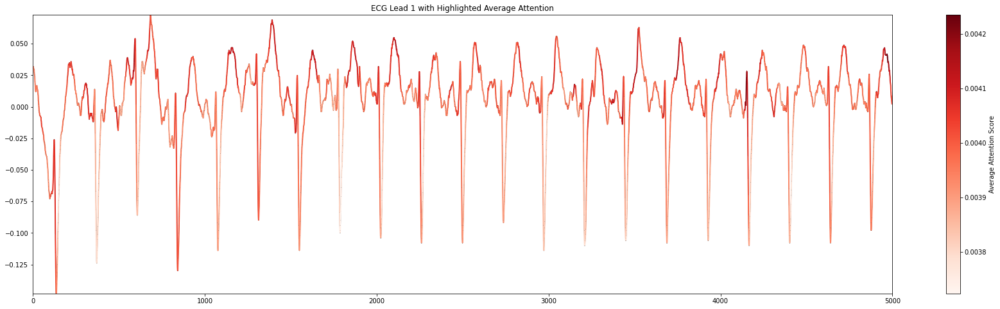

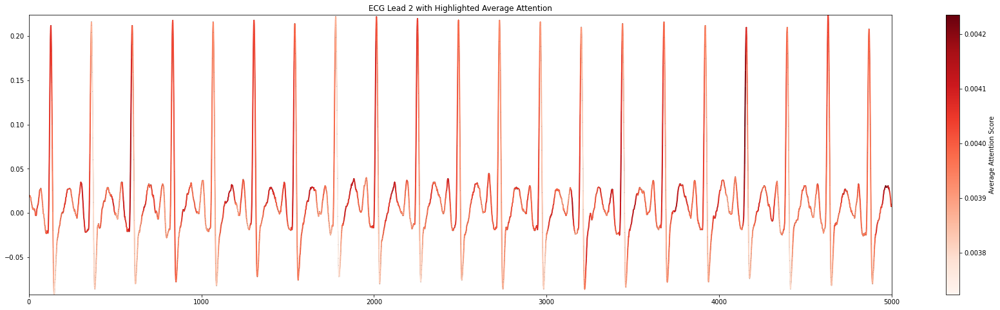

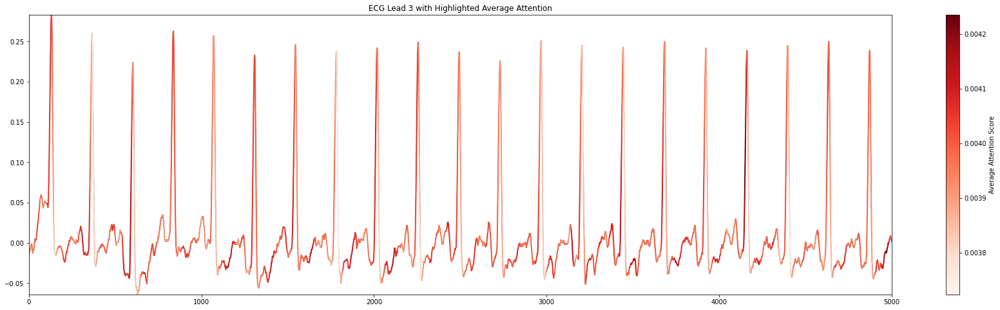

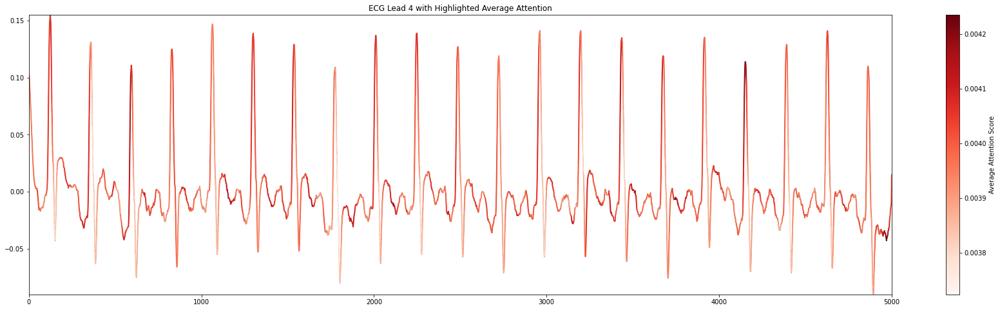

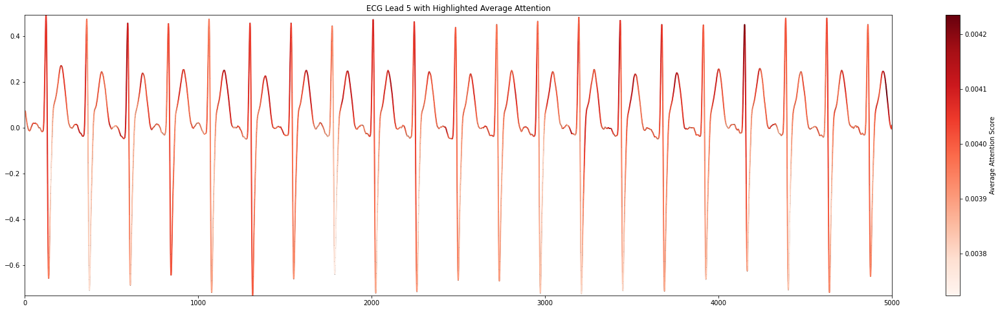

...

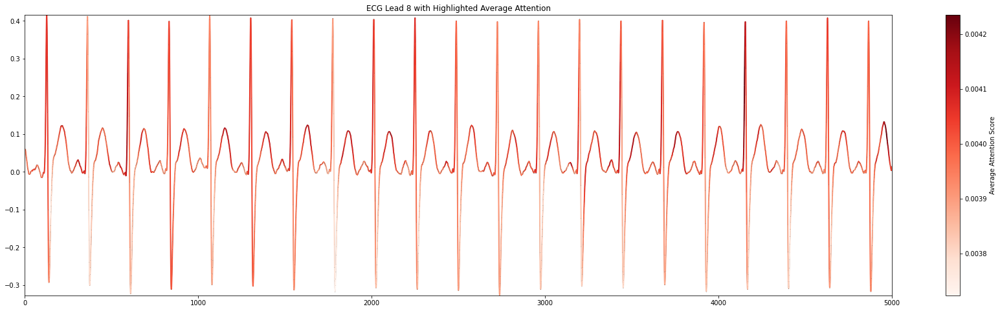

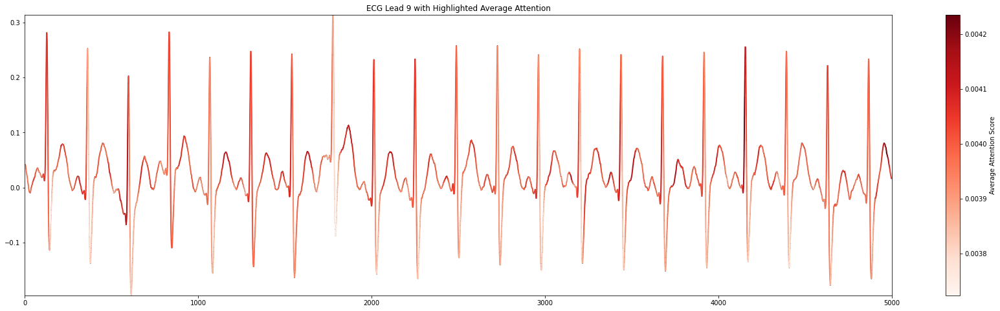

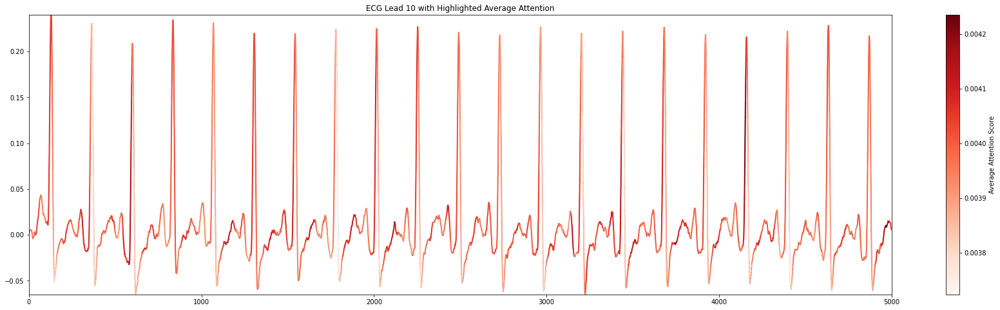

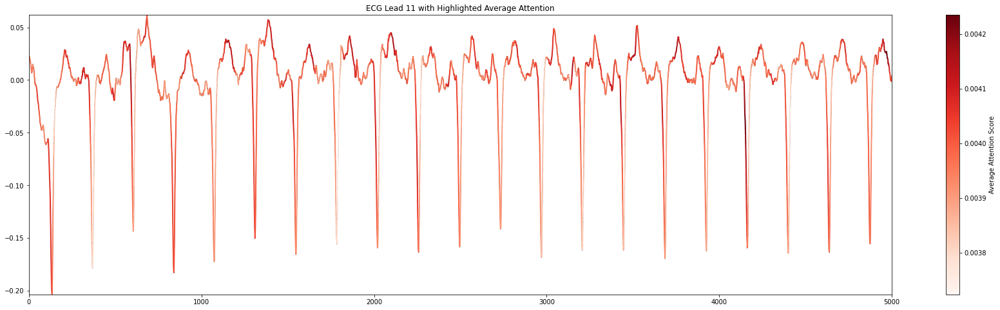

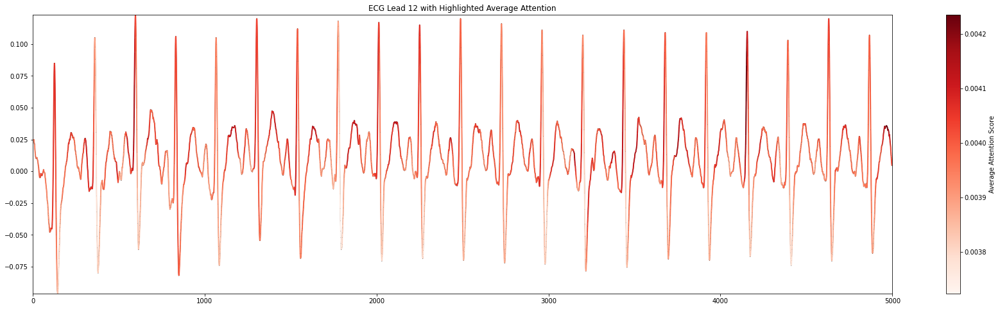

In [31]:
# 사용 예시
ecg_data = np.vstack([tot_df['WaveForm'].iloc[0][lead] for lead in sorted(tot_df['WaveForm'].iloc[0].keys())]).T  # (12, 5000) -> (5000, 12)
for i in range(12):
    model.plot_ecg_attention(ecg_data, vit, lead_index=i, weights_path='vit_best/')

##### 2) 사람별

In [83]:
# 사용 예시
vit_patch_size=20
vit_hidden_size=768
vit_depth=6
vit_num_heads=6
vit_mlp_dim=256
df = tot_df
vit, results = model.run_vit_training_patient(df, batch_size=32, epochs=20, test_size=0.1, 
                                        patch_size = vit_patch_size,
                                        hidden_size = vit_hidden_size,
                                        depth = vit_depth,
                                        num_heads = vit_num_heads,
                                        mlp_dim = vit_mlp_dim)
print(results)

# 사용 예시

Epoch 1/20


ValueError: in user code:

    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1021, in train_function  *
        return step_function(self, iterator)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1010, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 1000, in run_step  **
        outputs = model.train_step(data)
    File "/usr/local/lib/python3.8/dist-packages/keras/engine/training.py", line 859, in train_step
        y_pred = self(x, training=True)
    File "/usr/local/lib/python3.8/dist-packages/keras/utils/traceback_utils.py", line 67, in error_handler
        raise e.with_traceback(filtered_tb) from None

    ValueError: Exception encountered when calling layer "vision_transformer_2" (type VisionTransformer).
    
    in user code:
    
        File "/workspace/ecg/model.py", line 1711, in call  *
            x = self.embeddings(inputs, training=training)
        File "/usr/local/lib/python3.8/dist-packages/keras/utils/traceback_utils.py", line 67, in error_handler  **
            raise e.with_traceback(filtered_tb) from None
    
        ValueError: Exception encountered when calling layer "vi_t_embeddings_2" (type ViTEmbeddings).
        
        in user code:
        
            File "/workspace/ecg/model.py", line 1570, in call  *
                embeddings = self.patch_embeddings(inputs, training=training)
            File "/usr/local/lib/python3.8/dist-packages/keras/utils/traceback_utils.py", line 67, in error_handler  **
                raise e.with_traceback(filtered_tb) from None
        
            ValueError: Exception encountered when calling layer "conv1d_4" (type Conv1D).
            
            Negative dimension size caused by subtracting 20 from 12 for '{{node vision_transformer_2/vi_t_embeddings_2/conv1d_4/Conv1D}} = Conv2D[T=DT_FLOAT, data_format="NHWC", dilations=[1, 1, 1, 1], explicit_paddings=[], padding="VALID", strides=[1, 1, 20, 1], use_cudnn_on_gpu=true](vision_transformer_2/vi_t_embeddings_2/conv1d_4/Conv1D/ExpandDims, vision_transformer_2/vi_t_embeddings_2/conv1d_4/Conv1D/ExpandDims_1)' with input shapes: [?,1,12,5000], [1,20,5000,768].
            
            Call arguments received:
              • inputs=tf.Tensor(shape=(None, 12, 5000), dtype=float32)
        
        
        Call arguments received:
          • inputs=tf.Tensor(shape=(None, 12, 5000), dtype=float32)
          • training=True
    
    
    Call arguments received:
      • inputs=tf.Tensor(shape=(None, 12, 5000), dtype=float32)
      • training=True


In [24]:
table = tot_df[['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi']]

# 각 열의 값이 하나라도 있으면 1, NaN이면 0으로 대체
import pandas as pd
table = table.applymap(lambda x: 1 if pd.notna(x) and x != 0 else 0)
table = pd.concat((tot_df[['PatientID','AcquisitionDate','Age', 'Gender']],table), axis=1)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
table['Gender'] = le.fit_transform(table['Gender'])
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
table['Age'] = scaler.fit_transform(table[['Age']])
table['AcquisitionDate'] = pd.to_datetime(table['AcquisitionDate'])
tot_df['AcquisitionDate'] = pd.to_datetime(tot_df['AcquisitionDate'])
table = table.drop_duplicates(subset=table.columns.tolist())
concat_table = pd.merge(tot_df[['PatientID','AcquisitionDate','WaveForm','ProcessedWaveForm','Label']], table, how='left', on=['PatientID','AcquisitionDate'])
concat_table

,PatientID,AcquisitionDate,WaveForm,ProcessedWaveForm,Label,Age,Gender,scoliosis OP,Vent,Arrhythmia,BB,ARB,ACEi
0,2172946,2005-01-12,"{'I': [0.032, 0.032, 0.032, 0.032, 0.03, 0.03,...","{'I': [0.003489078248510284, 0.003424048884589...",1,0.487179,1,0,1,0,0,0,1
1,2172946,2005-01-12,"{'I': [0.014, 0.014, 0.014, 0.014, 0.015, 0.01...","{'I': [-0.001092086502907418, -0.0007955816212...",1,0.487179,1,0,1,0,0,0,1
2,2172946,2005-01-13,"{'I': [0.012, 0.012, 0.012, 0.012, 0.013, 0.01...","{'I': [-0.00071312700637069, -0.00044829021713...",1,0.487179,1,0,1,0,0,0,1
3,2172946,2005-01-13,"{'I': [0.006, 0.006, 0.006, 0.006, 0.008, 0.00...","{'I': [-0.002769777877337562, -0.0027443359588...",1,0.487179,1,0,1,0,0,0,1
4,2172946,2005-01-13,"{'I': [0.01, 0.01, 0.01, 0.01, 0.012, 0.012, 0...","{'I': [-0.001887300273430698, -0.0017362243296...",1,0.487179,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,2608828,2022-05-17,"{'I': [-0.02, -0.02, -0.02, -0.02, -0.022, -0....","{'I': [-0.005122427363618091, -0.0056354071314...",0,0.307692,1,0,0,0,0,0,1
490,2374756,2022-05-18,"{'I': [-0.008, -0.008, -0.008, -0.008, -0.006,...","{'I': [-0.0009398949308504023, -0.000745406959...",0,0.333333,1,0,0,0,1,1,1
491,2429758,2022-05-20,"{'I': [0.02, 0.02, 0.02, 0.02, 0.015, 0.01, 0....","{'I': [0.0010573135514592076, -3.8200843735528...",0,0.282051,1,0,0,0,1,0,1
492,2343631,2022-05-31,"{'I': [-0.01, -0.01, -0.01, -0.01, -0.013, -0....","{'I': [0.0010583006490491778, 0.00131258523873...",0,0.358974,1,0,0,0,0,0,1


In [81]:

# 예시 사용
vit_model = model.VisionTransformer(patch_size=10, hidden_size=768, depth=6, num_heads=6, mlp_dim=256, dropout = 0.1,num_classes=1)

# 사용자가 지정하는 Tabular feature 리스트
tabular_features = ['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi'] # 예시로 Age, Gender, BloodPressure을 포함

# 모델 학습 및 평가
combined_model, test_loss, test_roc_auc, test_accuracy = model.run_vit_tabular_cnn_training(concat_table, vit_model, tabular_features=tabular_features, random_state=42)



Epoch 1/20


KeyboardInterrupt: 

In [30]:
import tensorflow as tf
import numpy as np
import random
from tensorflow.keras.layers import Input, Dense, Concatenate
from tensorflow.keras.models import Model
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

def set_seed(seed=42):
    # Python 랜덤 시드 설정
    random.seed(seed)
    # NumPy 랜덤 시드 설정
    np.random.seed(seed)
    # TensorFlow 랜덤 시드 설정
    tf.random.set_seed(seed)

def run_vit_tabular_dense_training(
    df,
    vit_model,
    tabular_features,  # Tabular feature의 이름 리스트를 인자로 받음
    patch_size=10,
    hidden_size=768,
    depth=12,
    num_heads=12,
    mlp_dim=256,
    dropout=0.0,
    attention_dropout=0.0,
    learning_rate=0.0001,
    batch_size=32,
    epochs=20,
    test_size=0.1,
    random_state=42,
    sd_survival_probability=0.9,
):
    # 시드 설정 (모델 학습의 일관성을 위해)
    set_seed(random_state)
    
    # PatientID를 기준으로 데이터 나누기
    unique_patient_ids = df['PatientID'].unique()
    train_ids, test_ids = train_test_split(unique_patient_ids, test_size=test_size, random_state=random_state)

    train_df = df[df['PatientID'].isin(train_ids)]
    test_df = df[df['PatientID'].isin(test_ids)]

    # ViT 입력 데이터 전처리 (WaveForm 열에서 시계열 데이터를 전처리)
    X_train_vit = model.preprocess_data(train_df)
    y_train = np.array(train_df['Label'])
    X_test_vit = model.preprocess_data(test_df)
    y_test = np.array(test_df['Label'])

    # Tabular 데이터 추출
    # 사용자가 지정한 열들만 선택하여 Tabular 데이터를 구성
    X_train_tabular = np.array(train_df[tabular_features])
    X_test_tabular = np.array(test_df[tabular_features])

    # 데이터 정규화 (각 채널별로)
    scaler = StandardScaler()
    X_train_vit = X_train_vit.reshape(-1, X_train_vit.shape[-1])
    X_train_vit = scaler.fit_transform(X_train_vit)
    X_train_vit = X_train_vit.reshape(-1, 12, 5000)

    X_test_vit = X_test_vit.reshape(-1, X_test_vit.shape[-1])
    X_test_vit = scaler.transform(X_test_vit)
    X_test_vit = X_test_vit.reshape(-1, 12, 5000)

    # ViT 및 Tabular 데이터를 결합한 모델 생성
    combined_model = create_vit_tabular_dense_model(vit_model, len(tabular_features), hidden_size)

    # 모델 컴파일
    combined_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                           loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
                           metrics=[tf.keras.metrics.AUC(name='roc_auc'), 'accuracy'])

    # 모델 학습
    combined_model.fit([X_train_vit, X_train_tabular], y_train, epochs=epochs, batch_size=batch_size, validation_split=0.1)

    # 모델 평가 (테스트 데이터에서)
    test_loss, test_roc_auc, test_accuracy = combined_model.evaluate([X_test_vit, X_test_tabular], y_test, verbose=1)

    # 테스트 결과 출력
    print(f"Test Loss: {test_loss}")
    print(f"Test ROC AUC: {test_roc_auc}")
    print(f"Test Accuracy: {test_accuracy}")

    return combined_model, test_loss, test_roc_auc, test_accuracy

def create_vit_tabular_dense_model(vit_model, num_tabular_features, hidden_size, num_classes=1):
    # ViT 모델의 출력
    vit_input = Input(shape=(12, 5000))  # ViT 모델의 입력
    vit_output = vit_model(vit_input)  # ViT의 출력, shape: (batch_size, hidden_size)
    
    # Tabular 피처 입력
    tabular_input = Input(shape=(num_tabular_features,))  # 테이블형 피처의 입력
    
    # ViT 출력과 Tabular 피처 결합
    combined = Concatenate()([vit_output, tabular_input])
    
    # Dense Layer로 결합된 출력을 처리하여 예측 수행
    x = Dense(hidden_size, activation='relu')(combined)
    x = Dense(hidden_size // 2, activation='relu')(x)
    output = Dense(num_classes, activation='sigmoid')(x)

    # 최종 모델 정의
    model = Model(inputs=[vit_input, tabular_input], outputs=output)
    return model

In [30]:

# 예시 사용
vit_model = model.VisionTransformer(patch_size=10, hidden_size=768, depth=6, num_heads=6, mlp_dim=256, dropout = 0.1,num_classes=1)

# 사용자가 지정하는 Tabular feature 리스트
tabular_features = ['scoliosis OP','Vent', 
    # 'amiodarone', 'Ivabradine', 'carvedilol', 'other betablocker', 'digoxin', 'Entresto']]
                'Arrhythmia', 'BB', 'ARB ', 'ACEi'] # 예시로 Age, Gender, BloodPressure을 포함

# 모델 학습 및 평가
combined_model, test_loss, test_roc_auc, test_accuracy = run_vit_tabular_dense_training(concat_table, vit_model, tabular_features=tabular_features, random_state=42)



NameError: name 'run_vit_tabular_dense_training' is not defined

: 

In [27]:
tot_df['Vent'].value_counts()

1    296
0     22
Name: Vent, dtype: int64

In [29]:
# 사용 예시
tabular_features = ['scoliosis OP', 'Vent', 'Arrhythmia', 'BB', 'ARB ', 'ACEi']  # 사용자가 지정한 Tabular 피처 리스트

# tot_df는 데이터프레임, batch_size, epoch, waveform 열 이름을 전달합니다.
model.run_vit_tabular_model(concat_table, batch_size=16, epoch=50, waveform='WaveForm', tabular_features=tabular_features)


Epoch [10/50], Train Loss: 0.6931
Epoch [20/50], Train Loss: 0.6931
Epoch [30/50], Train Loss: 0.6931
Epoch [40/50], Train Loss: 0.6931
Epoch [50/50], Train Loss: 0.6931
Training complete.
Test Accuracy: 0.8594
Test ROC AUC Score: 0.5000


# 추가 모델

In [85]:
add_df = tot_df[['PatientID','WaveForm','Label']]

In [86]:
add_df['Label'] = add_df['Label'].astype('int')

In [87]:
import torch
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import GroupShuffleSplit

class ECGDataset(Dataset):
    def __init__(self, dataframe):
        self.dataframe = dataframe
        self.leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        waveform_data = self.dataframe.iloc[idx]['WaveForm']
        # Stack the 12 leads into a tensor of shape (12, 5000)
        ecg_tensor = torch.tensor([waveform_data[lead] for lead in self.leads])
        label = torch.tensor(self.dataframe.iloc[idx]['Label'], dtype=torch.long)
        return ecg_tensor, label

# Load your DataFrame
df = add_df

# Use GroupShuffleSplit to split data by PatientID
gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(df, groups=df['PatientID']))

# Create the train and test DataFrames
train_df = df.iloc[train_idx]
test_df = df.iloc[test_idx]

# Create the datasets and data loaders
train_dataset = ECGDataset(train_df)
test_dataset = ECGDataset(test_df)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)


In [88]:
import torch
import torch.nn as nn

class InvertedResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride, expand_ratio):
        super(InvertedResidualBlock, self).__init__()
        hidden_dim = round(in_channels * expand_ratio)
        self.use_res_connect = stride == 1 and in_channels == out_channels

        layers = []
        if expand_ratio != 1:
            layers.append(nn.Conv1d(in_channels, hidden_dim, kernel_size=1, stride=1, padding=0, bias=False))
            layers.append(nn.BatchNorm1d(hidden_dim))
            layers.append(nn.ReLU6(inplace=True))

        layers.extend([
            nn.Conv1d(hidden_dim, hidden_dim, kernel_size=3, stride=stride, padding=1, groups=hidden_dim, bias=False),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU6(inplace=True),
            nn.Conv1d(hidden_dim, out_channels, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm1d(out_channels),
        ])
        self.conv = nn.Sequential(*layers)

    def forward(self, x):
        if self.use_res_connect:
            return x + self.conv(x)
        else:
            return self.conv(x)

class CNNBackbone(nn.Module):
    def __init__(self, input_channels=12, channels=[32, 64, 128, 256, 512], expand_ratio=6):
        super(CNNBackbone, self).__init__()
        self.layers = nn.Sequential(
            nn.Conv1d(input_channels, channels[0], kernel_size=3, stride=2, padding=1),
            nn.BatchNorm1d(channels[0]),
            nn.ReLU6(inplace=True),
            InvertedResidualBlock(channels[0], channels[1], stride=2, expand_ratio=expand_ratio),
            InvertedResidualBlock(channels[1], channels[2], stride=2, expand_ratio=expand_ratio),
            InvertedResidualBlock(channels[2], channels[3], stride=2, expand_ratio=expand_ratio),
            InvertedResidualBlock(channels[3], channels[4], stride=2, expand_ratio=expand_ratio),
            nn.AdaptiveAvgPool1d(1),
        )

    def forward(self, x):
        return self.layers(x)

class Transformer(nn.Module):
    def __init__(self, input_dim, num_heads, num_layers, num_classes):
        super(Transformer, self).__init__()
        self.encoder_layer = nn.TransformerEncoderLayer(d_model=input_dim, nhead=num_heads)
        self.transformer_encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(input_dim, num_classes)

    def forward(self, x):
        x = self.transformer_encoder(x)  # x shape: (seq_len, batch_size, features)
        x = x.mean(dim=0)  # Reduce seq_len dimension, resulting in (batch_size, features)
        x = self.fc(x)  # Fully connected layer: output shape (batch_size, num_classes)
        return x

class ECGDETR(nn.Module):
    def __init__(self, num_classes=2, channels=[32, 64, 128, 256, 512]):
        super(ECGDETR, self).__init__()
        self.backbone = CNNBackbone(channels=channels)
        self.transformer = Transformer(input_dim=channels[-1], num_heads=8, num_layers=4, num_classes=num_classes)

    def forward(self, x):
        x = self.backbone(x)  # x shape: (batch_size, channels[-1], seq_len)
        x = x.permute(2, 0, 1)  # Permute to (seq_len, batch_size, channels[-1]) for Transformer
        x = self.transformer(x)  # Output from Transformer
        return x  # x shape: (batch_size, num_classes)


In [96]:
# Example usage with different channel sizes
channels = [8, 16, 32, 64, 128]  # You can experiment with these values
model = ECGDETR(num_classes=2, channels=channels).to(device)

import torch.optim as optim
from sklearn.metrics import accuracy_score, roc_auc_score

# Example channels configuration
# channels = [64, 128, 256, 512, 1024]

model = ECGDETR(num_classes=2, channels=channels).to(device)  # Move model to GPU
criterion = nn.CrossEntropyLoss().to(device)  # Move loss function to GPU
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
for epoch in range(10):  # Number of epochs
    model.train()
    all_labels = []
    all_preds = []
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device) # Move data to GPU
        
        optimizer.zero_grad()
        outputs = model(inputs)

        # Calculate loss
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Collect predictions and labels for accuracy and AUROC calculation
        _, preds = torch.max(outputs, 1)
        all_labels.extend(labels.cpu().numpy())  # Move labels back to CPU for metric calculation
        all_preds.extend(preds.cpu().numpy())  # Move predictions back to CPU for metric calculation

    # Calculate accuracy and AUROC for training
    train_accuracy = accuracy_score(all_labels, all_preds)
    train_auroc = roc_auc_score(all_labels, all_preds)

    print(f"Epoch {epoch+1}, Loss: {loss.item()}, Accuracy: {train_accuracy}, AUROC: {train_auroc}")

# Validation loop
model.eval()
all_labels = []
all_preds = []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)  # Move data to GPU
        
        outputs = model(inputs)

        # Collect predictions and labels for accuracy and AUROC calculation
        _, preds = torch.max(outputs, 1)
        all_labels.extend(labels.cpu().numpy())  # Move labels back to CPU for metric calculation
        all_preds.extend(preds.cpu().numpy())  # Move predictions back to CPU for metric calculation

    # Calculate accuracy and AUROC for validation
    val_accuracy = accuracy_score(all_labels, all_preds)
    val_auroc = roc_auc_score(all_labels, all_preds)
    val_loss = criterion(outputs, labels)

    print(f"Validation Loss: {val_loss.item()}, Accuracy: {val_accuracy}, AUROC: {val_auroc}")


Epoch 1, Loss: 0.1372801661491394, Accuracy: 0.815359477124183, AUROC: 0.5072098949592889
Epoch 2, Loss: 0.6661643385887146, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 3, Loss: 0.50572669506073, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 4, Loss: 1.0440452098846436, Accuracy: 0.8398692810457516, AUROC: 0.5084219031636522
Epoch 5, Loss: 0.04096724092960358, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 6, Loss: 0.09946716576814651, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 7, Loss: 0.2716817855834961, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 8, Loss: 0.16175717115402222, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 9, Loss: 0.15316914021968842, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 10, Loss: 0.17971166968345642, Accuracy: 0.8480392156862745, AUROC: 0.5
Validation Loss: 0.23322927951812744, Accuracy: 0.8529411764705882, AUROC: 0.5


In [102]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import GroupShuffleSplit

# Custom ECGDataset class for loading data from DataFrame
class ECGDataset(Dataset):
    def __init__(self, dataframe):
        self.dataframe = dataframe
        self.leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        waveform_data = self.dataframe.iloc[idx]['WaveForm']
        # Stack the 12 leads into a tensor of shape (12, 5000)
        ecg_tensor = torch.tensor([waveform_data[lead] for lead in self.leads])
        label = torch.tensor(self.dataframe.iloc[idx]['Label'], dtype=torch.long)
        return ecg_tensor, label

# Assuming `df` is your DataFrame containing ECG data
# Use GroupShuffleSplit to split data by PatientID
gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(df, groups=df['PatientID']))

# Create the train and test DataFrames
train_df = df.iloc[train_idx]
test_df = df.iloc[test_idx]

# Create the datasets and data loaders
train_dataset = ECGDataset(train_df)
test_dataset = ECGDataset(test_df)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Model configuration parameters
num_layers = 4
num_classes = 2  # Binary classification
input_channels = 12  # 12 ECG leads
embed_size = 64  # Embedding size for the Transformer
num_heads = 4  # Number of attention heads
expansion = 4  # Expansion factor in the MLP

device = "cuda" if torch.cuda.is_available() else "cpu"
lr = 1e-4
num_epochs = 20
validation_frequency = 2

# Define the ECGformer model
class ECGformer(nn.Module):
    def __init__(self, num_layers, num_classes, input_channels, embed_size, num_heads, expansion):
        super(ECGformer, self).__init__()
        self.encoder = nn.ModuleList([TransformerEncoderLayer(
            embed_size=embed_size, num_heads=num_heads, expansion=expansion) for _ in range(num_layers)])
        self.classifier = nn.Sequential(
            nn.Linear(embed_size, embed_size),
            nn.LayerNorm(embed_size),
            nn.Linear(embed_size, num_classes)
        )
        self.embedding = nn.Conv1d(input_channels, embed_size, kernel_size=1)

    def forward(self, x):
        x = self.embedding(x)  # (batch_size, embed_size, seq_len)
        x = x.permute(2, 0, 1)  # (seq_len, batch_size, embed_size)
        for layer in self.encoder:
            x = layer(x)
        x = x.mean(dim=0)  # (batch_size, embed_size)
        return self.classifier(x).squeeze()

# Instantiate the model, optimizer, and loss function
model = ECGformer(
    num_layers=num_layers,
    num_classes=num_classes,
    input_channels=input_channels,
    embed_size=embed_size,
    num_heads=num_heads,
    expansion=expansion
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=lr)
criterion = nn.BCEWithLogitsLoss().to(device)

# Training loop
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    all_labels = []
    all_preds = []

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device).float()

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        preds = torch.sigmoid(outputs) > 0.5
        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(preds.cpu().numpy())

    train_accuracy = accuracy_score(all_labels, all_preds)
    train_auroc = roc_auc_score(all_labels, all_preds)

    print(f"Epoch {epoch+1}, Loss: {epoch_loss/len(train_loader)}, Accuracy: {train_accuracy}, AUROC: {train_auroc}")

    # Validation loop
    if (epoch + 1) % validation_frequency == 0:
        model.eval()
        all_labels = []
        all_preds = []
        val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in test_loader:
                inputs, labels = inputs.to(device), labels.to(device).float()

                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                preds = torch.sigmoid(outputs) > 0.5
                all_labels.extend(labels.cpu().numpy())
                all_preds.extend(preds.cpu().numpy())

        val_accuracy = accuracy_score(all_labels, all_preds)
        val_auroc = roc_auc_score(all_labels, all_preds)

        print(f"Validation Loss: {val_loss/len(test_loader)}, Accuracy: {val_accuracy}, AUROC: {val_auroc}")


NameError: name 'TransformerEncoderLayer' is not defined

In [103]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import GroupShuffleSplit

# Custom ECGDataset class for loading data from DataFrame
class ECGDataset(Dataset):
    def __init__(self, dataframe):
        self.dataframe = dataframe
        self.leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        waveform_data = self.dataframe.iloc[idx]['WaveForm']
        # Stack the 12 leads into a tensor of shape (12, 5000)
        ecg_tensor = torch.tensor([waveform_data[lead] for lead in self.leads])
        label = torch.tensor(self.dataframe.iloc[idx]['Label'], dtype=torch.long)
        return ecg_tensor, label

# Assuming `df` is your DataFrame containing ECG data
# Use GroupShuffleSplit to split data by PatientID
gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(df, groups=df['PatientID']))

# Create the train and test DataFrames
train_df = df.iloc[train_idx]
test_df = df.iloc[test_idx]

# Create the datasets and data loaders
train_dataset = ECGDataset(train_df)
test_dataset = ECGDataset(test_df)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Model configuration parameters
num_layers = 4
num_classes = 2  # Binary classification
input_channels = 12  # 12 ECG leads
embed_size = 64  # Embedding size for the Transformer
num_heads = 4  # Number of attention heads
expansion = 4  # Expansion factor in the MLP

device = "cuda" if torch.cuda.is_available() else "cpu"
lr = 1e-4
num_epochs = 20
validation_frequency = 2

# Define the Transformer components
class MLP(nn.Sequential):
    def __init__(self, input_channels, expansion=4):
        super().__init__(*[
            nn.Linear(input_channels, input_channels * expansion),
            nn.GELU(),
            nn.Linear(input_channels * expansion, input_channels)
        ])

class MultiHeadAttention(torch.nn.Module):
    def __init__(self, embed_size, num_heads):
        super().__init__()
        self.queries_projection = nn.Linear(embed_size, embed_size)
        self.values_projection = nn.Linear(embed_size, embed_size)
        self.keys_projection = nn.Linear(embed_size, embed_size)
        self.final_projection = nn.Linear(embed_size, embed_size)
        self.embed_size = embed_size
        self.num_heads = num_heads

    def forward(self, x):
        assert len(x.shape) == 3
        keys = self.keys_projection(x)
        values = self.values_projection(x)
        queries = self.queries_projection(x)
        keys = keys.view(x.size(0), -1, self.num_heads, self.embed_size // self.num_heads)
        queries = queries.view(x.size(0), -1, self.num_heads, self.embed_size // self.num_heads)
        values = values.view(x.size(0), -1, self.num_heads, self.embed_size // self.num_heads)
        
        energy_term = torch.einsum("bqhe, bkhe -> bqhk", queries, keys)
        divider = torch.sqrt(torch.tensor(self.embed_size, dtype=torch.float32))
        mh_out = torch.softmax(energy_term / divider, dim=-1)
        out = torch.einsum('bihv, bvhd -> bihd', mh_out, values)
        out = out.contiguous().view(x.size(0), -1, self.embed_size)
        return self.final_projection(out)

class ResidualAdd(nn.Module):
    def __init__(self, layer, dropout=0.1):
        super(ResidualAdd, self).__init__()
        self.layer = layer
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        return x + self.dropout(self.layer(x))

class TransformerEncoderLayer(nn.Sequential):
    def __init__(self, embed_size=768, expansion=4, num_heads=8):
        super(TransformerEncoderLayer, self).__init__(
            *[
                ResidualAdd(nn.Sequential(*[
                    nn.LayerNorm(embed_size),
                    MultiHeadAttention(embed_size, num_heads)
                ])),
                ResidualAdd(nn.Sequential(*[
                    nn.LayerNorm(embed_size),
                    MLP(embed_size, expansion)
                ]))
            ]
        )

# Define the ECGformer model
class ECGformer(nn.Module):
    def __init__(self, num_layers, num_classes, input_channels, embed_size, num_heads, expansion):
        super(ECGformer, self).__init__()
        self.encoder = nn.ModuleList([TransformerEncoderLayer(
            embed_size=embed_size, num_heads=num_heads, expansion=expansion) for _ in range(num_layers)])
        self.classifier = nn.Sequential(
            nn.Linear(embed_size, embed_size),
            nn.LayerNorm(embed_size),
            nn.Linear(embed_size, num_classes)
        )
        self.embedding = nn.Conv1d(input_channels, embed_size, kernel_size=1)

    def forward(self, x):
        x = self.embedding(x)  # (batch_size, embed_size, seq_len)
        x = x.permute(2, 0, 1)  # (seq_len, batch_size, embed_size)
        for layer in self.encoder:
            x = layer(x)
        x = x.mean(dim=0)  # (batch_size, embed_size)
        return self.classifier(x).squeeze()

# Instantiate the model, optimizer, and loss function
model = ECGformer(
    num_layers=num_layers,
    num_classes=num_classes,
    input_channels=input_channels,
    embed_size=embed_size,
    num_heads=num_heads,
    expansion=expansion
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=lr)
criterion = nn.BCEWithLogitsLoss().to(device)

# Training loop
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    all_labels = []
    all_preds = []

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device).float()

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        preds = torch.sigmoid(outputs) > 0.5
        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(preds.cpu().numpy())

    train_accuracy = accuracy_score(all_labels, all_preds)
    train_auroc = roc_auc_score(all_labels, all_preds)

    print(f"Epoch {epoch+1}, Loss: {epoch_loss/len(train_loader)}, Accuracy: {train_accuracy}, AUROC: {train_auroc}")

    # Validation loop
    if (epoch + 1) % validation_frequency == 0:
        model.eval()
        all_labels = []
        all_preds = []
        val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in test_loader:
                inputs, labels = inputs.to(device), labels.to(device).float()

                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                preds = torch.sigmoid(outputs) > 0.5
                all_labels.extend(labels.cpu().numpy())
                all_preds.extend(preds.cpu().numpy())

        val_accuracy = accuracy_score(all_labels, all_preds)
        val_auroc = roc_auc_score(all_labels, all_preds)

        print(f"Validation Loss: {val_loss/len(test_loader)}, Accuracy: {val_accuracy}, AUROC: {val_auroc}")


ValueError: Target size (torch.Size([32])) must be the same as input size (torch.Size([32, 2]))

In [104]:
# Change the criterion to CrossEntropyLoss
criterion = nn.CrossEntropyLoss().to(device)

# No need to apply sigmoid in the training loop, as CrossEntropyLoss expects raw logits
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    all_labels = []
    all_preds = []

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        preds = torch.argmax(outputs, dim=1)  # Get class predictions from logits
        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(preds.cpu().numpy())

    train_accuracy = accuracy_score(all_labels, all_preds)
    train_auroc = roc_auc_score(all_labels, all_preds)

    print(f"Epoch {epoch+1}, Loss: {epoch_loss/len(train_loader)}, Accuracy: {train_accuracy}, AUROC: {train_auroc}")

    # Validation loop
    if (epoch + 1) % validation_frequency == 0:
        model.eval()
        all_labels = []
        all_preds = []
        val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in test_loader:
                inputs, labels = inputs.to(device), labels.to(device)

                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                preds = torch.argmax(outputs, dim=1)
                all_labels.extend(labels.cpu().numpy())
                all_preds.extend(preds.cpu().numpy())

        val_accuracy = accuracy_score(all_labels, all_preds)
        val_auroc = roc_auc_score(all_labels, all_preds)

        print(f"Validation Loss: {val_loss/len(test_loader)}, Accuracy: {val_accuracy}, AUROC: {val_auroc}")


Epoch 1, Loss: 0.4682622589170933, Accuracy: 0.8218954248366013, AUROC: 0.519889365404935
Epoch 2, Loss: 0.4171063743531704, Accuracy: 0.8480392156862745, AUROC: 0.5
Validation Loss: 0.37960295379161835, Accuracy: 0.8529411764705882, AUROC: 0.5
Epoch 3, Loss: 0.4368332207202911, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 4, Loss: 0.45284161195158956, Accuracy: 0.8480392156862745, AUROC: 0.5
Validation Loss: 0.3833763152360916, Accuracy: 0.8529411764705882, AUROC: 0.5
Epoch 5, Loss: 0.4358002170920372, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 6, Loss: 0.4344931557774544, Accuracy: 0.8480392156862745, AUROC: 0.5
Validation Loss: 0.37873040735721586, Accuracy: 0.8529411764705882, AUROC: 0.5
Epoch 7, Loss: 0.41634825244545937, Accuracy: 0.8480392156862745, AUROC: 0.5
Epoch 8, Loss: 0.4156590551137924, Accuracy: 0.8480392156862745, AUROC: 0.5
Validation Loss: 0.37907610833644867, Accuracy: 0.8529411764705882, AUROC: 0.5
Epoch 9, Loss: 0.4539210245013237, Accuracy: 0.84803921568627

In [105]:
# Modify the classifier to output a single logit
self.classifier = nn.Sequential(
    nn.Linear(embed_size, embed_size),
    nn.LayerNorm(embed_size),
    nn.Linear(embed_size, 1)  # Output a single value
)

# Keep the criterion as BCEWithLogitsLoss
criterion = nn.BCEWithLogitsLoss().to(device)

# Ensure labels are float for BCEWithLogitsLoss
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    all_labels = []
    all_preds = []

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device).float()

        optimizer.zero_grad()
        outputs = model(inputs).squeeze()  # Ensure the output is of shape [batch_size]
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        preds = torch.sigmoid(outputs) > 0.5  # Apply sigmoid to get binary predictions
        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(preds.cpu().numpy())

    train_accuracy = accuracy_score(all_labels, all_preds)
    train_auroc = roc_auc_score(all_labels, all_preds)

    print(f"Epoch {epoch+1}, Loss: {epoch_loss/len(train_loader)}, Accuracy: {train_accuracy}, AUROC: {train_auroc}")

    # Validation loop
    if (epoch + 1) % validation_frequency == 0:
        model.eval()
        all_labels = []
        all_preds = []
        val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in test_loader:
                inputs, labels = inputs.to(device), labels.to(device).float()

                outputs = model(inputs).squeeze()
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                preds = torch.sigmoid(outputs) > 0.5
                all_labels.extend(labels.cpu().numpy())
                all_preds.extend(preds.cpu().numpy())

        val_accuracy = accuracy_score(all_labels, all_preds)
        val_auroc = roc_auc_score(all_labels, all_preds)

        print(f"Validation Loss: {val_loss/len(test_loader)}, Accuracy: {val_accuracy}, AUROC: {val_auroc}")


NameError: name 'self' is not defined

In [111]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CNNModule(nn.Module):
    def __init__(self, input_channels=12):
        super(CNNModule, self).__init__()
        self.conv1 = nn.Conv1d(input_channels, 64, kernel_size=7, stride=1, padding=3)
        self.conv2 = nn.Conv1d(64, 128, kernel_size=5, stride=1, padding=2)
        self.conv3 = nn.Conv1d(128, 256, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv1d(256, 256, kernel_size=3, stride=1, padding=1)
        self.conv5 = nn.Conv1d(256, 256, kernel_size=3, stride=1, padding=1)
        self.conv6 = nn.Conv1d(256, 256, kernel_size=3, stride=1, padding=1)
        self.pool = nn.MaxPool1d(2, 2)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = self.pool(F.relu(self.conv4(x)))
        x = self.pool(F.relu(self.conv5(x)))
        x = self.pool(F.relu(self.conv6(x)))
        return x


In [112]:
class TransformerModule(nn.Module):
    def __init__(self, embed_size=256, num_heads=8, num_layers=4, dropout=0.1):
        super(TransformerModule, self).__init__()
        self.transformer_layer = nn.TransformerEncoderLayer(
            d_model=embed_size, nhead=num_heads, dropout=dropout)
        self.transformer = nn.TransformerEncoder(self.transformer_layer, num_layers=num_layers)

    def forward(self, x):
        x = self.transformer(x)
        return x


In [119]:
class ECGClassificationModel(nn.Module):
    def __init__(self, num_windows, input_channels=12, embed_size=256, num_heads=8, num_layers=4, num_classes=2):
        super(ECGClassificationModel, self).__init__()
        self.cnn = CNNModule(input_channels=input_channels)
        self.transformer = TransformerModule(embed_size=embed_size, num_heads=num_heads, num_layers=num_layers)
        self.classifier = nn.Sequential(
            nn.Linear(embed_size, embed_size),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(embed_size, num_classes),
            nn.Softmax(dim=-1)
        )

    def forward(self, x):
        if len(x.shape) == 3:  # If input shape is (batch_size, channels, length)
            batch_size, channels, length = x.size()
            num_windows = 1
            x = x.unsqueeze(1)  # Add a window dimension: (batch_size, 1, channels, length)
        else:
            batch_size, num_windows, channels, length = x.size()
        
        x = x.view(batch_size * num_windows, channels, length)
        
        # Pass each window through the CNN
        x = self.cnn(x)  # Output shape: (batch_size * num_windows, 256, reduced_length)
        
        x = x.view(batch_size, num_windows, -1).permute(1, 0, 2)  # (num_windows, batch_size, embed_size)
        
        # Pass through the transformer
        x = self.transformer(x)  # Output shape: (num_windows, batch_size, embed_size)
        
        x = x.mean(dim=0)  # Average over windows to get the final representation (batch_size, embed_size)
        
        # Classification layer
        output = self.classifier(x)  # Output shape: (batch_size, num_classes)
        return output


In [120]:
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import GroupShuffleSplit

class ECGDataset(Dataset):
    def __init__(self, dataframe):
        self.dataframe = dataframe
        self.leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        waveform_data = self.dataframe.iloc[idx]['WaveForm']
        ecg_tensor = torch.tensor([waveform_data[lead] for lead in self.leads])
        label = torch.tensor(self.dataframe.iloc[idx]['Label'], dtype=torch.long)
        return ecg_tensor, label

# Split the data
df = add_df  # Assuming you have your DataFrame `df`
gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(df, groups=df['PatientID']))

train_df = df.iloc[train_idx]
test_df = df.iloc[test_idx]

# Data loaders
train_dataset = ECGDataset(train_df)
test_dataset = ECGDataset(test_df)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Instantiate and train the model
device = "cuda" if torch.cuda.is_available() else "cpu"
model = ECGClassificationModel(num_windows=5, num_classes=2).to(device)  # Assuming 5 windows
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
criterion = nn.CrossEntropyLoss()

num_epochs = 20
# Adjusting the batch loading in the DataLoader
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for inputs, labels in train_loader:
        # Assuming each 'inputs' is already in the shape (batch_size, num_windows, channels, length)
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)  # Inputs should already be shaped correctly
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader)}')


# Validation loop
model.eval()
total_loss = 0
correct = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.view(-1, 5, 12, 5000)  # Reshape to (batch_size, num_windows, 12, 5000)
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        total_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        correct += (predicted == labels).sum().item()

print(f'Validation Loss: {total_loss/len(test_loader)}, Accuracy: {correct/len(test_loader.dataset)}')


AssertionError: was expecting embedding dimension of 256, but got 19968